In [1]:
import sys
import regions
import pyavm
import numpy as np
import PIL

from astropy.io import fits
from astropy.wcs import WCS
from astropy.wcs.utils import proj_plane_pixel_scales
from astropy.visualization import simple_norm

import reproject 
from reproject.mosaicking import find_optimal_celestial_wcs, reproject_and_coadd
import matplotlib.pyplot as plt
from matplotlib.colors import rgb_to_hsv, hsv_to_rgb

from astropy.table import Table
from astropy.nddata import Cutout2D
from astropy.coordinates import SkyCoord
from astropy import units as u

from reproject import reproject_interp

from spectral_cube import SpectralCube
from spectral_cube import Projection

from photutils.background import MMMBackground, MADStdBackgroundRMS, Background2D
from photutils import background

import regions
import cv2

import warnings

from astropy.visualization.wcsaxes import add_scalebar
from astropy.visualization.wcsaxes import add_beam

In [2]:
warnings.filterwarnings("ignore")

In [3]:
cat = Table.read('/orange/adamginsburg/jwst/cloudc/F2550W/f2550w__crowdsource_nsky1_real.fits')
miri_fn = '/orange/adamginsburg/jwst/cloudc/images/jw02221-o001_t001_miri_f2550w_realigned-to-refcat.fits'
f405n_fn = '/orange/adamginsburg/jwst/cloudc/images/jw02221-o002_t001_nircam_clear-f405n-merged_i2d.fits'
B6_cont_fn = '/orange/adamginsburg/jwst/cloudc/alma/member.uid___A001_X1590_X282a.CloudC_sci.spw29.mfs.I.manual.image.pbcor.fits'
B3_cont_fn = '/orange/adamginsburg/jwst/cloudc/alma/ACES/uid___A001_X15a0_X1a8.s36_0.Sgr_A_star_sci.spw33_35.cont.I.iter1.image.tt0'
#B6_cont = fits.open(B6_cont_fn)[0]

In [4]:
def get_cutout(filename, position, l, w, format='fits'):
    if format == 'fits':
        try: 
            hdu = fits.open(filename)
            data = np.squeeze(hdu['SCI'].data)
            head = hdu['SCI'].header
        except: 
            hdu = fits.open(filename)[0]
            data = np.squeeze(hdu.data)
            head = hdu.header
    elif format == 'casa':
        hdu = SpectralCube.read(filename, format='casa').hdu
        data = np.squeeze(hdu.data)
        head = hdu.header
    

    #pixel_scale = head['PIXSCALE']*u.arcsec/u.pix
    ww = WCS(head).celestial
    size = (l, w)
    #((l/pixel_scale).to(u.pix), (w/pixel_scale).to(u.pix))
    cutout = Cutout2D(data, position=position, size=size, wcs=ww)
    return cutout

def get_cutout_rgb(position, l, w):
    #filename_R = '/orange/adamginsburg/jwst/cloudc/images/F405_reproj_merged-fortricolor.fits'
    filename_R = '/orange/adamginsburg/jwst/cloudc/images/F466_reproj_merged-fortricolor.fits'
    #filename_B = '/orange/adamginsburg/jwst/cloudc/images/F187_reproj_merged-fortricolor.fits'
    filename_B = '/orange/adamginsburg/jwst/cloudc/images/F405_reproj_merged-fortricolor.fits'
    cutout_R = get_cutout(filename_R, position, l, w)
    cutout_B = get_cutout(filename_B, position, l, w)
    cutout_G = cutout_R.data + cutout_B.data
    rgb = np.array(
        [
            cutout_R.data,
            cutout_G,
            cutout_B.data
        ]
    ).swapaxes(0,2).swapaxes(0,1)
    rgb_scaled = np.array([
        simple_norm(rgb[:,:,0], stretch='asinh', min_cut=-1, max_cut=90)(rgb[:,:,0]),
        simple_norm(rgb[:,:,1], stretch='asinh', min_cut=-2, max_cut=210)(rgb[:,:,1]),
        simple_norm(rgb[:,:,2], stretch='asinh', min_cut=-1, max_cut=120)(rgb[:,:,2]),
    ]).swapaxes(0,2)
    return rgb_scaled.swapaxes(0,1), cutout_R.wcs

def get_cutout_rgb3(position, l, w):
    #filename_R = '/orange/adamginsburg/jwst/cloudc/images/F405_reproj_merged-fortricolor.fits'
    filename_R = '/orange/adamginsburg/jwst/cloudc/images/F410_reproj_merged-fortricolor.fits'
    filename_G = '/orange/adamginsburg/jwst/cloudc/images/F212_reproj_merged-fortricolor.fits'
    filename_B = '/orange/adamginsburg/jwst/cloudc/images/F182_reproj_merged-fortricolor.fits'
    cutout_R = get_cutout(filename_R, position, l, w)
    cutout_G = get_cutout(filename_G, position, l, w)
    cutout_B = get_cutout(filename_B, position, l, w)
    
    rgb = np.array(
        [
            cutout_R.data,
            cutout_G.data,
            cutout_B.data
        ]
    ).swapaxes(0,2).swapaxes(0,1)
    rgb_scaled = np.array([
        simple_norm(rgb[:,:,0], stretch='asinh', min_cut=-1, max_cut=120)(rgb[:,:,0]),
        simple_norm(rgb[:,:,1], stretch='asinh', min_cut=-2, max_cut=210)(rgb[:,:,1]),
        simple_norm(rgb[:,:,2], stretch='asinh', min_cut=-1, max_cut=120)(rgb[:,:,2]),
    ]).swapaxes(0,2)
    return rgb_scaled.swapaxes(0,1), cutout_R.wcs

def get_percentile_list(data, percents=[98, 99, 99.9, 99.99]):
    #[87, 95, 99, 99.5, 99.9, 99.99]
    arr = []
    for per in percents:
        arr.append(np.nanpercentile(data, per))
    return np.array(arr)

def get_miri(position, l, w):
    miri_fn = '/orange/adamginsburg/jwst/cloudc/images/jw02221-o001_t001_miri_f2550w_realigned-to-refcat.fits'
    cutout_miri = get_cutout(miri_fn, position, l, w)
    return cutout_miri

def get_alma(position, l, w):
    B6_cont_fn = '/orange/adamginsburg/jwst/cloudc/alma/member.uid___A001_X1590_X282a.CloudC_sci.spw29.mfs.I.manual.image.pbcor.fits'
    cutout_alma = get_cutout(B6_cont_fn, position, l, w)
    return cutout_alma

def get_alma_B3(position, l, w):
    B3_cont_fn = '/orange/adamginsburg/jwst/cloudc/alma/ACES/uid___A001_X15a0_X1a8.s36_0.Sgr_A_star_sci.spw33_35.cont.I.iter1.image.tt0'
    cutout_alma = get_cutout(B3_cont_fn, position, l, w)
    return cutout_alma

def get_sio_mom0(position, l, w):
    SiO_mom0_fn_lowv = '/orange/adamginsburg/jwst/cloudc/alma/moments/mom0_SiO_B6_n10_p40.fits'
    SiO_mom0_fn_highv = '/orange/adamginsburg/jwst/cloudc/alma/moments/mom0_SiO_B6_p40_p90.fits'
    cutout_lowv = get_cutout(SiO_mom0_fn_lowv, position, l, w)
    cutout_highv = get_cutout(SiO_mom0_fn_highv, position, l, w)
    return cutout_lowv, cutout_highv

def get_sio_mom0_B3(position, l, w):
    SiO_mom0_fn_lowv = '/orange/adamginsburg/jwst/cloudc/alma/moments/mom0_SiO_B3_n10_p40.fits'
    SiO_mom0_fn_highv = '/orange/adamginsburg/jwst/cloudc/alma/moments/mom0_SiO_B3_p40_p90.fits'
    cutout_lowv = get_cutout(SiO_mom0_fn_lowv, position, l, w)
    cutout_highv = get_cutout(SiO_mom0_fn_highv, position, l, w)
    return cutout_lowv, cutout_highv

def get_sio_mom0_filament(position, l, w):
    SiO_mom0_fn_lowv = '/orange/adamginsburg/jwst/cloudc/alma/moments/mom0_SiO_B3_n60_n55.fits'
    SiO_mom0_fn_highv = '/orange/adamginsburg/jwst/cloudc/alma/moments/mom0_SiO_B3_n55_n50.fits'
    cutout_lowv = get_cutout(SiO_mom0_fn_lowv, position, l, w)
    cutout_highv = get_cutout(SiO_mom0_fn_highv, position, l, w)
    return cutout_lowv, cutout_highv

def get_cs_mom0_filament(position, l, w):
    SiO_mom0_fn_lowv = '/orange/adamginsburg/jwst/cloudc/alma/moments/mom0_CS_B3_n60_n55.fits'
    SiO_mom0_fn_highv = '/orange/adamginsburg/jwst/cloudc/alma/moments/mom0_CS_B3_n55_n50.fits'
    cutout_lowv = get_cutout(SiO_mom0_fn_lowv, position, l, w)
    cutout_highv = get_cutout(SiO_mom0_fn_highv, position, l, w)
    return cutout_lowv, cutout_highv

def get_co_mom0(position, l, w):
    CO_mom0_fn_lowv = '/orange/adamginsburg/jwst/cloudc/alma/moments/mom0_CO_21_B6_n10_p40.fits'
    CO_mom0_fn_highv = '/orange/adamginsburg/jwst/cloudc/alma/moments/mom0_CO_21_B6_p40_p90.fits'
    cutout_lowv = get_cutout(CO_mom0_fn_lowv, position, l, w)
    cutout_highv = get_cutout(CO_mom0_fn_highv, position, l, w)
    return cutout_lowv, cutout_highv

def get_c18o_mom0(position, l, w):
    CO_mom0_fn_lowv = '/orange/adamginsburg/jwst/cloudc/alma/moments/mom0_C18O_21_B6_n10_p40.fits'
    CO_mom0_fn_highv = '/orange/adamginsburg/jwst/cloudc/alma/moments/mom0_C18O_21_B6_p40_p90.fits'
    cutout_lowv = get_cutout(CO_mom0_fn_lowv, position, l, w)
    cutout_highv = get_cutout(CO_mom0_fn_highv, position, l, w)
    return cutout_lowv, cutout_highv

def get_c18o_mom0_32(position, l, w):
    CO_mom0_fn_lowv = '/orange/adamginsburg/jwst/cloudc/alma/moments/mom0_C18O_21_B6_p17_p32.fits'
    CO_mom0_fn_highv = '/orange/adamginsburg/jwst/cloudc/alma/moments/mom0_C18O_21_B6_p32_p47.fits'
    cutout_lowv = get_cutout(CO_mom0_fn_lowv, position, l, w)
    cutout_highv = get_cutout(CO_mom0_fn_highv, position, l, w)
    return cutout_lowv, cutout_highv

def get_nircam(position, l, w):
    filename = '/orange/adamginsburg/jwst/cloudc/images/F405_reproj_merged-fortricolor.fits'
    cutout_f405n = get_cutout(filename, position, l, w)
    return cutout_f405n

def plot_sio_mom0(ax, position, l, w):
    cutout_lowv, cutout_highv = get_sio_mom0(position, l, w)
    
    ax.contour(cutout_highv.data, transform=ax.get_transform(cutout_highv.wcs), 
               levels=get_percentile_list(cutout_highv.data), 
               colors='red', linewidths=1.)
    ax.contour(cutout_lowv.data, transform=ax.get_transform(cutout_lowv.wcs), 
               levels=get_percentile_list(cutout_lowv.data), 
               colors='blue', linewidths=1.)

def plot_sio_mom0_B3(ax, position, l, w):
    cutout_lowv, cutout_highv = get_sio_mom0_B3(position, l, w)
    
    ax.contour(cutout_highv.data, transform=ax.get_transform(cutout_highv.wcs), 
               levels=get_percentile_list(cutout_highv.data, percents=[70, 80, 90, 95, 98]), 
               colors='red', linewidths=1.)
    ax.contour(cutout_lowv.data, transform=ax.get_transform(cutout_lowv.wcs), 
               levels=get_percentile_list(cutout_lowv.data, percents=[70, 80, 90, 95, 98]), 
               colors='blue', linewidths=1.)
    
def plot_sio_mom0_filament(ax, position, l, w):
    cutout_lowv, cutout_highv = get_sio_mom0_filament(position, l, w)
    
    ax.contour(cutout_highv.data, transform=ax.get_transform(cutout_highv.wcs), 
               levels=get_percentile_list(cutout_highv.data, percents=[70, 80, 90, 95, 98]), 
               colors='red', linewidths=1.)
    ax.contour(cutout_lowv.data, transform=ax.get_transform(cutout_lowv.wcs), 
               levels=get_percentile_list(cutout_lowv.data, percents=[70, 80, 90, 95, 98]), 
               colors='blue', linewidths=1.)
    
def plot_cs_mom0_filament(ax, position, l, w):
    cutout_lowv, cutout_highv = get_cs_mom0_filament(position, l, w)
    
    ax.contour(cutout_highv.data, transform=ax.get_transform(cutout_highv.wcs), 
               levels=get_percentile_list(cutout_highv.data, percents=[70, 80, 90, 95, 98]), 
               colors='red', linewidths=1.)
    ax.contour(cutout_lowv.data, transform=ax.get_transform(cutout_lowv.wcs), 
               levels=get_percentile_list(cutout_lowv.data, percents=[70, 80, 90, 95, 98]), 
               colors='blue', linewidths=1.)

def plot_co_mom0(ax, position, l, w):
    cutout_lowv, cutout_highv = get_co_mom0(position, l-0.5*u.arcsec, w-0.5*u.arcsec)
    
    ax.contour(cutout_highv.data, transform=ax.get_transform(cutout_highv.wcs), 
               levels=get_percentile_list(cutout_highv.data), 
               colors='orange', linewidths=1.)
    ax.contour(cutout_lowv.data, transform=ax.get_transform(cutout_lowv.wcs), 
               levels=get_percentile_list(cutout_lowv.data), 
               colors='cyan', linewidths=1.)
    
def plot_c18o_mom0(ax, position, l, w):
    cutout_lowv, cutout_highv = get_c18o_mom0(position, l-0.5*u.arcsec, w-0.5*u.arcsec)
    
    ax.contour(cutout_highv.data, transform=ax.get_transform(cutout_highv.wcs), 
               levels=get_percentile_list(cutout_highv.data), 
               colors='orangered', linewidths=1.)
    ax.contour(cutout_lowv.data, transform=ax.get_transform(cutout_lowv.wcs), 
               levels=get_percentile_list(cutout_lowv.data), 
               colors='blueviolet', linewidths=1.)
    
def plot_c18o_mom0_32(ax, position, l, w):
    cutout_lowv, cutout_highv = get_c18o_mom0_32(position, l-0.5*u.arcsec, w-0.5*u.arcsec)
    
    ax.contour(cutout_highv.data, transform=ax.get_transform(cutout_highv.wcs), 
               levels=get_percentile_list(cutout_highv.data), 
               colors='orangered', linewidths=1.)
    ax.contour(cutout_lowv.data, transform=ax.get_transform(cutout_lowv.wcs), 
               levels=get_percentile_list(cutout_lowv.data), 
               colors='blueviolet', linewidths=1.)
    
def plot_cont_contour(ax, position, l, w):
    cutout = get_alma(position, l-0.5*u.arcsec, w-0.5*u.arcsec)
    
    ax.contour(cutout.data, transform=ax.get_transform(cutout.wcs), 
               levels=get_percentile_list(cutout.data), 
               colors='white', linewidths=1.)

In [5]:
def plot_compare_miri_alma(position, l, w):
    try: 
        fig = plt.figure(figsize=(12, 8))
        cutout_miri = get_miri(position, l, w)
        cutout_alma = get_alma(position, l, w)
        cutout_rgb, rgb_wcs = get_cutout_rgb(position, l, w)

        ax1 = plt.subplot(141, projection=cutout_miri.wcs)
        ax1.imshow(np.nan_to_num(cutout_miri.data), cmap='inferno', vmin=850, vmax=970)
        ax1.scatter(position.ra, position.dec, edgecolor='green', facecolor='none', transform=ax1.get_transform('world'))
        ax1.text(1, 1, "F2550W", fontsize=12, color='white')
        ax1.set_xlabel('Right Ascension')
        ax1.set_ylabel('Declination')

        ax2 = plt.subplot(142, projection=cutout_alma.wcs)
        ax2.imshow(np.nan_to_num(cutout_alma.data), cmap='Greys')
        ax2.scatter(position.ra, position.dec, edgecolor='green', facecolor='none', transform=ax2.get_transform('world'), zorder=5)
        plot_sio_mom0(ax2, position, l, w)
        ax2.text(10, 10, "SiO J=5-4", fontsize=12)
        ax2.set_xlabel('Right Ascension')
        ax2.set_ylabel('Declination')
        
        ax3 = plt.subplot(143, projection=cutout_alma.wcs)
        ax3.imshow(np.nan_to_num(cutout_alma.data), cmap='Greys')
        ax3.scatter(position.ra, position.dec, edgecolor='green', facecolor='none', transform=ax3.get_transform('world'), zorder=5)
        plot_co_mom0(ax3, position, l, w)
        ax3.text(10, 10, "CO J=2-1", fontsize=12)
        ax3.set_xlabel('Right Ascension')
        ax3.set_ylabel('Declination')
        
        ax4 = plt.subplot(144, projection=rgb_wcs)
        ax4.imshow(cutout_rgb)
        ax4.scatter(position.ra, position.dec, edgecolor='green', facecolor='none', transform=ax4.get_transform('world'))
        ax4.text(10, 10, "F466N & F405N", fontsize=12, color='white')
        #plot_cont_contour(ax4, position, l, w)
        ax4.set_xlabel('Right Ascension')
        ax4.set_ylabel('Declination')

        plt.tight_layout()
        plt.show()
    except:
        print('no overlap')
        
def plot_compare_miri_alma_rgb3(position, l, w):
    try: 
        fig = plt.figure(figsize=(12, 8))
        cutout_miri = get_miri(position, l, w)
        cutout_alma = get_alma(position, l, w)
        cutout_rgb, rgb_wcs = get_cutout_rgb3(position, l, w)

        ax1 = plt.subplot(141, projection=cutout_miri.wcs)
        ax1.imshow(np.nan_to_num(cutout_miri.data), cmap='inferno', vmin=850, vmax=970)
        ax1.scatter(position.ra, position.dec, edgecolor='lime', facecolor='none', transform=ax1.get_transform('world'))
        ax1.text(1, 1, "F2550W", fontsize=12, color='white')
        ax1.set_xlabel('Right Ascension')
        ax1.set_ylabel('Declination')

        ax2 = plt.subplot(142, projection=cutout_alma.wcs)
        ax2.imshow(np.nan_to_num(cutout_alma.data), cmap='Greys')
        ax2.scatter(position.ra, position.dec, edgecolor='green', facecolor='none', transform=ax2.get_transform('world'), zorder=5)
        plot_sio_mom0(ax2, position, l, w)
        ax2.text(10, 10, "SiO J=5-4", fontsize=12)
        ax2.set_xlabel('Right Ascension')
        ax2.set_ylabel('Declination')
        
        ax3 = plt.subplot(143, projection=cutout_alma.wcs)
        ax3.imshow(np.nan_to_num(cutout_alma.data), cmap='Greys')
        ax3.scatter(position.ra, position.dec, edgecolor='green', facecolor='none', transform=ax3.get_transform('world'), zorder=5)
        plot_co_mom0(ax3, position, l, w)
        ax3.text(10, 10, "CO J=2-1", fontsize=12)
        ax3.set_xlabel('Right Ascension')
        ax3.set_ylabel('Declination')
        
        ax4 = plt.subplot(144, projection=rgb_wcs)
        ax4.imshow(cutout_rgb)
        ax4.scatter(position.ra, position.dec, edgecolor='lime', facecolor='none', transform=ax4.get_transform('world'))
        #ax4.text(10, 10, "F410M-F212N-F182M", fontsize=12, color='white')
        ax4.text(10, 10, 'F410M', color='red', fontsize=12)
        ax4.text(60, 10, 'F212N', color='lime', fontsize=12)
        ax4.text(110, 10, 'F182M', color='dodgerblue', fontsize=12)
        #plot_cont_contour(ax4, position, l, w)
        ax4.set_xlabel('Right Ascension')
        ax4.set_ylabel('Declination')

        plt.tight_layout()
        plt.show()
    except:
        print('no overlap')
        
def plot_compare_outflow(position, l, w):
    try: 
        fig = plt.figure(figsize=(12, 8))
        cutout_alma = get_alma(position, l, w)
        #cutout_rgb, rgb_wcs = get_cutout_rgb(position, l, w)
        
        ax1 = plt.subplot(131, projection=cutout_alma.wcs)
        ax1.imshow(np.nan_to_num(cutout_alma.data), cmap='Greys')
        plot_sio_mom0(ax1, position, l, w)
        ax1.scatter(position.ra, position.dec, color='lime', marker='*', transform=ax1.get_transform('world'), zorder=2)
        ax1.set_xlabel('Right Ascension')
        ax1.set_ylabel('Declination')
        ax1.text(10, 10, "SiO J=5-4", color='k', fontsize=16)
        add_beam(ax1, header=fits.getheader(B6_cont_fn), corner='bottom right', color='white', linestyle='dashed', facecolor='none')

        ax2 = plt.subplot(132, projection=cutout_alma.wcs)
        ax2.imshow(np.nan_to_num(cutout_alma.data), cmap='Greys')
        plot_co_mom0(ax2, position, l, w)
        ax2.scatter(position.ra, position.dec, color='lime', marker='*', transform=ax2.get_transform('world'), zorder=2)
        ax2.set_xlabel('Right Ascension')
        ax2.set_ylabel('Declination')
        ax2.text(10, 10, "CO J=2-1", color='k', fontsize=16)

        ax3 = plt.subplot(133, projection=cutout_alma.wcs)
        ax3.imshow(np.nan_to_num(cutout_alma.data), cmap='Greys')
        plot_c18o_mom0(ax3, position, l, w)
        ax3.scatter(position.ra, position.dec, color='lime', marker='*', transform=ax3.get_transform('world'), zorder=2)
        ax3.set_xlabel('Right Ascension')
        ax3.set_ylabel('Declination')
        ax3.text(10, 10, "C$^{18}$O J=2-1", color='k', fontsize=16)
        
        plt.tight_layout()
        plt.show()
        
    except: 
        print('no overlap')



In [6]:
def compare_sio_outflows(position, l, w):
    fig = plt.figure(figsize=(12, 8))
    cutout_alma = get_alma(position, l, w)
    #cutout_rgb, rgb_wcs = get_cutout_rgb(position, l, w)
    ax1 = plt.subplot(121, projection=cutout_alma.wcs)
    ax1.imshow(np.nan_to_num(cutout_alma.data), cmap='Greys')
    plot_sio_mom0(ax1, position, l, w)
    ax1.scatter(position.ra, position.dec, color='lime', marker='*', transform=ax1.get_transform('world'), zorder=2)
    ax1.set_xlabel('Right Ascension')
    ax1.set_ylabel('Declination')
    ax1.text(10, 10, "SiO J=5-4", color='k', fontsize=16)
    add_beam(ax1, header=fits.getheader(B6_cont_fn), corner='bottom right', color='k', linestyle='dashed', facecolor='none')

    ax2 = plt.subplot(122, projection=cutout_alma.wcs)
    ax2.imshow(np.nan_to_num(cutout_alma.data), cmap='Greys')
    plot_sio_mom0_B3(ax2, position, l, w)
    ax2.scatter(position.ra, position.dec, color='lime', marker='*', transform=ax2.get_transform('world'), zorder=2)
    ax2.set_xlabel('Right Ascension')
    ax2.set_ylabel('Declination')
    ax2.text(10, 10, "SiO J=2-1", color='k', fontsize=16)
    add_beam(ax2, header=SpectralCube.read(B3_cont_fn, format='casa').hdu.header, corner='bottom right', color='k', 
             linestyle='dashed', facecolor='none')
    
    plt.tight_layout()
    plt.show()
        
def compare_co_outflows(position, l, w):
    fig = plt.figure(figsize=(12, 8))
    cutout_alma = get_alma(position, l, w)
    #cutout_rgb, rgb_wcs = get_cutout_rgb(position, l, w)
    ax1 = plt.subplot(121, projection=cutout_alma.wcs)
    ax1.imshow(np.nan_to_num(cutout_alma.data), cmap='Greys', vmax=0.006736109490663259)
    plot_co_mom0(ax1, position, l, w)
    ax1.scatter(position.ra, position.dec, color='lime', marker='*', transform=ax1.get_transform('world'), zorder=2)
    ax1.set_xlabel('Right Ascension')
    ax1.set_ylabel('Declination')
    ax1.text(10, 10, "CO J=2-1", color='k', fontsize=16)
    add_beam(ax1, header=fits.getheader(B6_cont_fn), corner='bottom right', color='k', linestyle='dashed', facecolor='none')

    ax2 = plt.subplot(122, projection=cutout_alma.wcs)
    ax2.imshow(np.nan_to_num(cutout_alma.data), cmap='Greys', vmax=0.006736109490663259)
    plot_c18o_mom0(ax2, position, l, w)
    ax2.scatter(position.ra, position.dec, color='lime', marker='*', transform=ax2.get_transform('world'), zorder=2)
    ax2.set_xlabel('Right Ascension')
    ax2.set_ylabel('Declination')
    ax2.text(10, 10, "C$^{18}$O J=2-1", color='k', fontsize=16)
    add_beam(ax2, header=fits.getheader(B6_cont_fn), corner='bottom right', color='k', 
             linestyle='dashed', facecolor='none')
    
    plt.tight_layout()
    plt.show()

In [7]:
cat_use = cat[cat['real_miri']]
crds_use = cat_use['skycoord']

reg = regions.Regions.read('/orange/adamginsburg/jwst/cloudc/regions_/alma_fov.reg')
ww = WCS(fits.open(miri_fn)['SCI'].header)
cat_in = cat_use[reg[0].contains(crds_use, wcs=ww)]
crds_in = cat_in['skycoord']

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


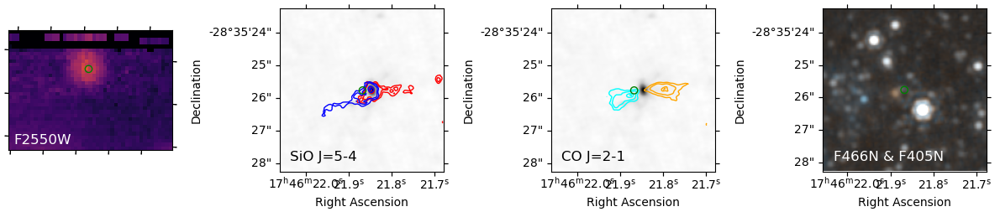

In [8]:
l = w = 5*u.arcsec
position = crds_in[-2]
plot_compare_miri_alma(position, l, w)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


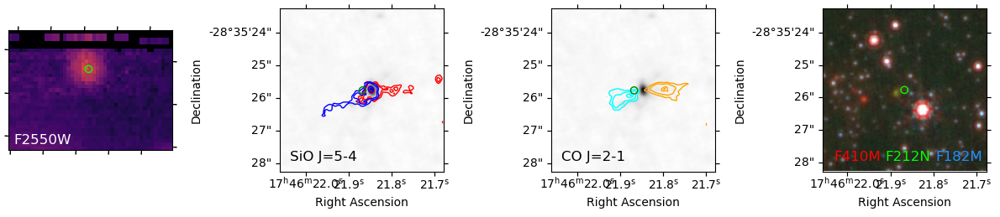

In [9]:
plot_compare_miri_alma_rgb3(position, l, w)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


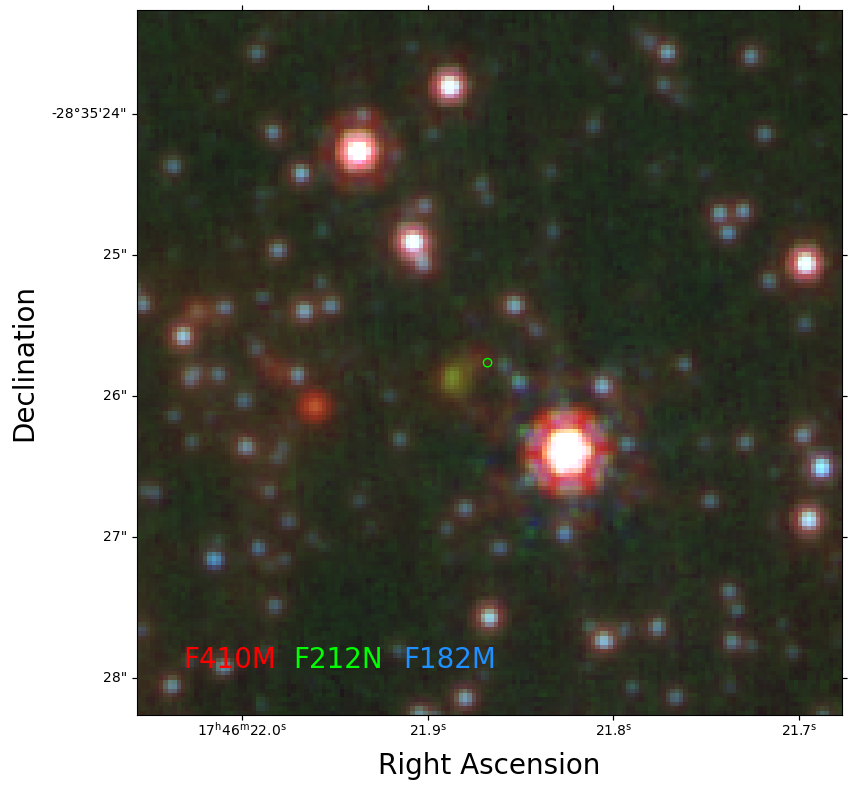

In [16]:
fig = plt.figure(figsize=(10, 8))

cutout_rgb, rgb_wcs = get_cutout_rgb3(position, l, w)
ax4 = plt.subplot(111, projection=rgb_wcs)
ax4.imshow(cutout_rgb)
ax4.scatter(position.ra, position.dec, edgecolor='lime', facecolor='none', transform=ax4.get_transform('world'))
#ax4.text(10, 10, "F410M-F212N-F182M", fontsize=12, color='white')
ax4.text(10, 10, 'F410M', color='red', fontsize=20)
ax4.text(35, 10, 'F212N', color='lime', fontsize=20)
ax4.text(60, 10, 'F182M', color='dodgerblue', fontsize=20)
#plot_cont_contour(ax4, position, l, w)
ax4.set_xlabel('Right Ascension', fontsize=20)
ax4.set_ylabel('Declination', fontsize=20)

plt.tight_layout()
plt.show()

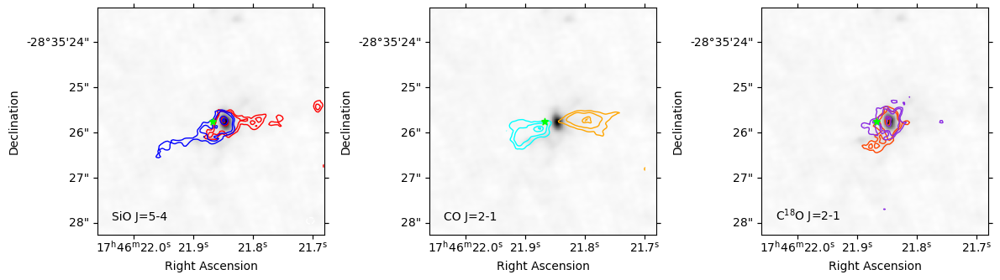

In [9]:
plot_compare_outflow(position, l, w)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


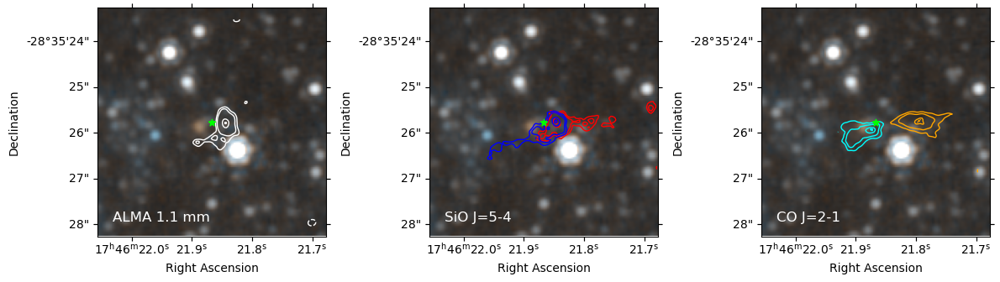

In [28]:
fig = plt.figure(figsize=(12, 6))
cutout_rgb, rgb_wcs = get_cutout_rgb(position, l, w)

ax1 = plt.subplot(131, projection=rgb_wcs)
ax1.imshow(cutout_rgb)
plot_cont_contour(ax1, position, l, w)
ax1.scatter(position.ra, position.dec, color='lime', marker='*', transform=ax1.get_transform('world'), zorder=2)
ax1.set_xlabel('Right Ascension')
ax1.set_ylabel('Declination')
ax1.text(10, 10, "ALMA 1.1 mm", color='white', fontsize=12)
add_beam(ax1, header=fits.getheader(B6_cont_fn), corner='bottom right', color='white', linestyle='dashed', facecolor='none')

ax2 = plt.subplot(132, projection=rgb_wcs)
ax2.imshow(cutout_rgb)
plot_sio_mom0(ax2, position, l, w)
ax2.scatter(position.ra, position.dec, color='lime', marker='*', transform=ax2.get_transform('world'), zorder=2)
ax2.set_xlabel('Right Ascension')
ax2.set_ylabel('Declination')
ax2.text(10, 10, "SiO J=5-4", color='white', fontsize=12)

ax3 = plt.subplot(133, projection=rgb_wcs)
ax3.imshow(cutout_rgb)
plot_co_mom0(ax3, position, l, w)
ax3.scatter(position.ra, position.dec, color='lime', marker='*', transform=ax3.get_transform('world'), zorder=2)
ax3.set_xlabel('Right Ascension')
ax3.set_ylabel('Declination')
ax3.text(10, 10, "CO J=2-1", color='white', fontsize=12)

plt.tight_layout()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(10, 10, 'C18O J=2-1')

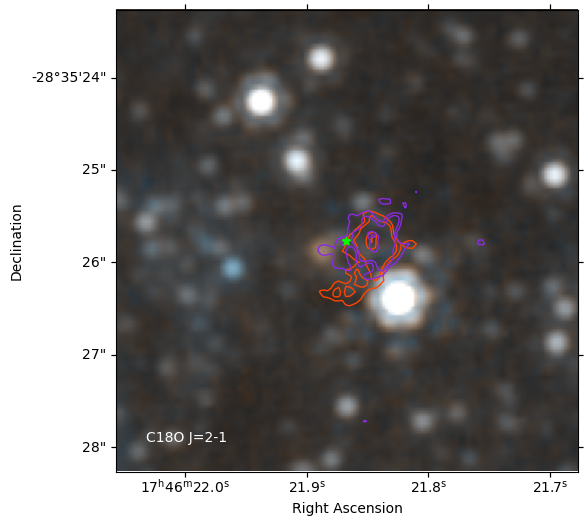

In [11]:
fig = plt.figure(figsize=(12, 6))
cutout_rgb, rgb_wcs = get_cutout_rgb(position, l, w)

ax3 = plt.subplot(111, projection=rgb_wcs)
ax3.imshow(cutout_rgb)
plot_c18o_mom0(ax3, position, l, w)
ax3.scatter(position.ra, position.dec, color='lime', marker='*', transform=ax3.get_transform('world'), zorder=2)
ax3.set_xlabel('Right Ascension')
ax3.set_ylabel('Declination')
ax3.text(10, 10, "C18O J=2-1", color='white')

Text(10, 10, 'C18O J=2-1')

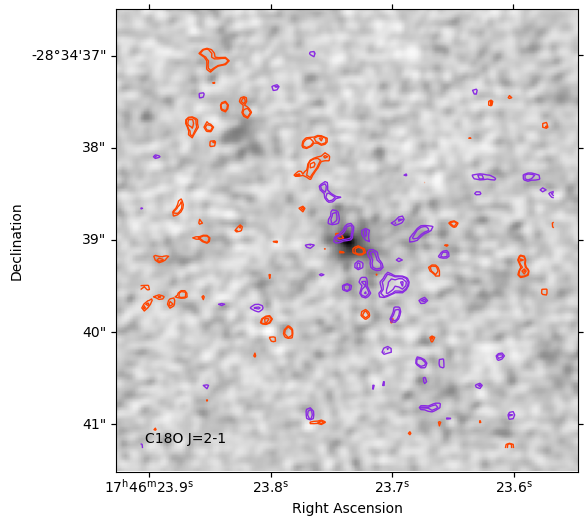

In [12]:
pos = SkyCoord('17:46:23.7345968605', '-28:34:39.0199007314', unit=(u.hourangle, u.deg))

fig = plt.figure(figsize=(12, 6))
cutout_alma = get_alma(pos, l, w)

ax3 = plt.subplot(111, projection=cutout_alma.wcs)
ax3.imshow(np.nan_to_num(cutout_alma.data), cmap='Greys')
plot_c18o_mom0_32(ax3, pos, l, w)
#ax3.scatter(position.ra, position.dec, color='lime', marker='*', transform=ax3.get_transform('world'), zorder=2)
ax3.set_xlabel('Right Ascension')
ax3.set_ylabel('Declination')
ax3.text(10, 10, "C18O J=2-1", color='k')

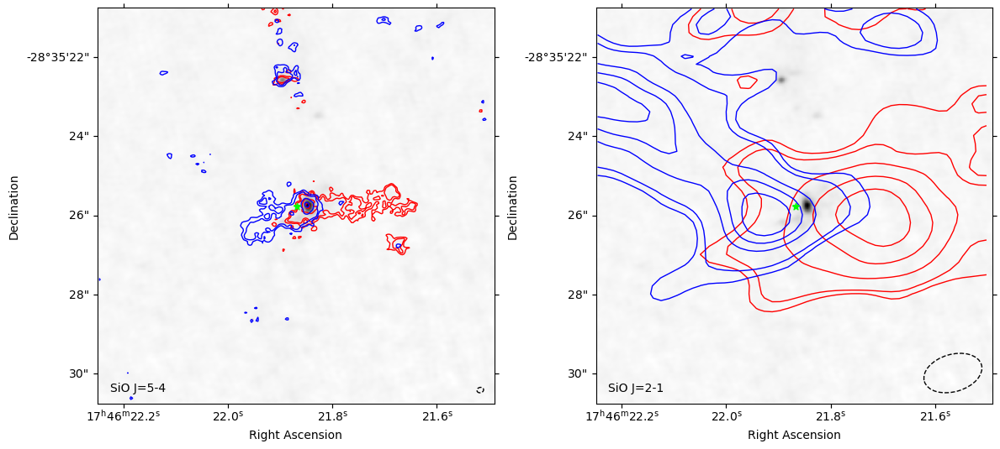

In [15]:
compare_sio_outflows(position, 10*u.arcsec, 10*u.arcsec)

In [10]:
pos1 = SkyCoord('17:46:22.1901249178', '-28:35:12.0298363464', unit=(u.hourangle, u.deg))
pos2 = SkyCoord('17:46:22.0595262710', '-28:35:14.8911215655', unit=(u.hourangle, u.deg))
pos3 = SkyCoord('17:46:21.8932235260', '-28:35:21.2252551605', unit=(u.hourangle, u.deg))
pos4 = SkyCoord('17:46:21.8927124860', '-28:35:22.6184380115', unit=(u.hourangle, u.deg))
pos5 = SkyCoord('17:46:21.8431976476', '-28:35:25.7885897107', unit=(u.hourangle, u.deg))
pos6 = SkyCoord('17:46:21.5314341270', '-28:35:18.4627111804', unit=(u.hourangle, u.deg))
pos7 = SkyCoord('17:46:21.2847916342', '-28:35:18.8965598649', unit=(u.hourangle, u.deg))
pos8 = SkyCoord('17:46:20.9812853413', '-28:35:38.0024179042', unit=(u.hourangle, u.deg))
pos9 = SkyCoord('17:46:20.5431539790', '-28:35:39.3711532752', unit=(u.hourangle, u.deg))
pos_msy = SkyCoord('17:46:21.7149436622', '-28:35:20.9551473744', unit=(u.hourangle, u.deg))
position_hmsfr = SkyCoord('17:46:21.4695266413', '-28:35:38.2082071644', unit=(u.hourangle, u.deg))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


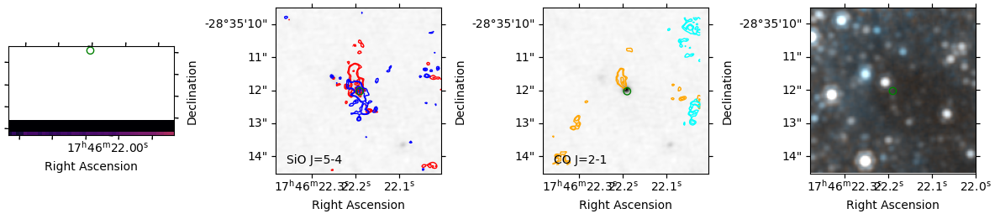

In [169]:
plot_compare_miri_alma(pos1, l, w)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


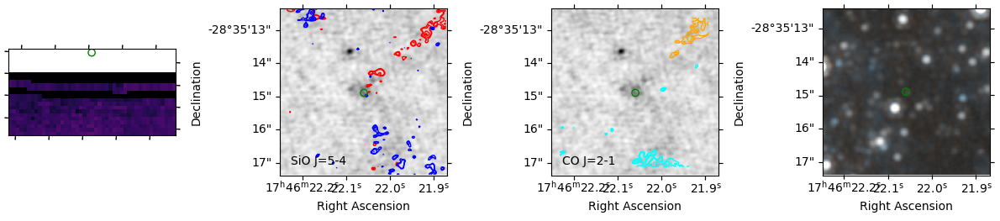

In [170]:
plot_compare_miri_alma(pos2, l, w)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


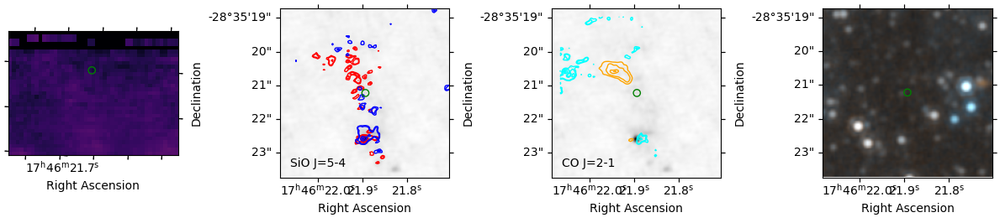

In [171]:
plot_compare_miri_alma(pos3, l, w)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


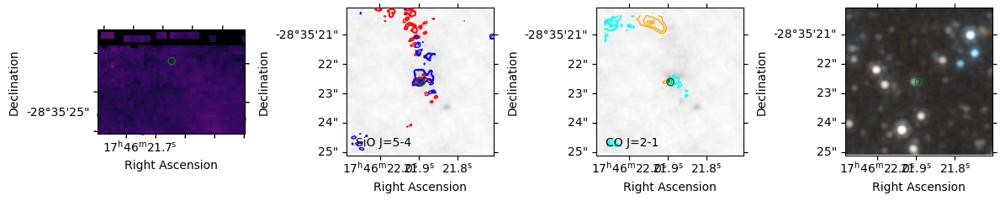

In [172]:
plot_compare_miri_alma(pos4, l, w)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


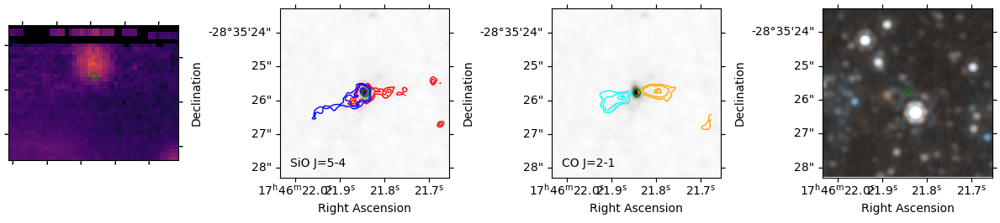

In [173]:
plot_compare_miri_alma(pos5, l, w)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


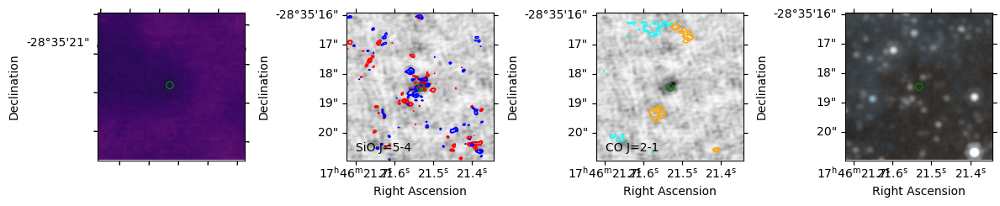

In [174]:
plot_compare_miri_alma(pos6, l, w)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


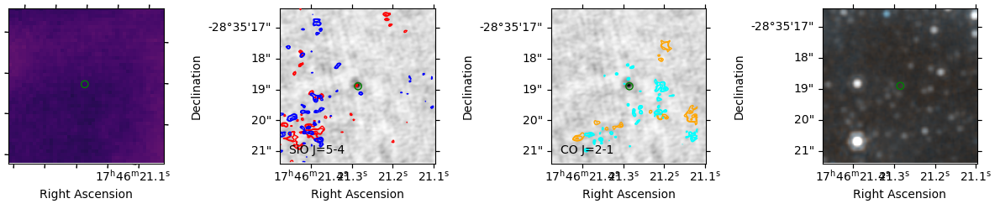

In [175]:
plot_compare_miri_alma(pos7, l, w)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


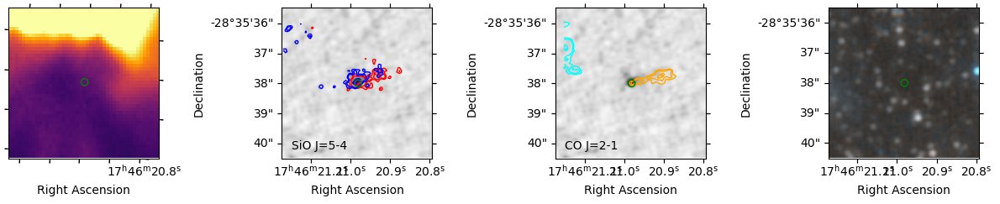

In [176]:
plot_compare_miri_alma(pos8, l, w)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


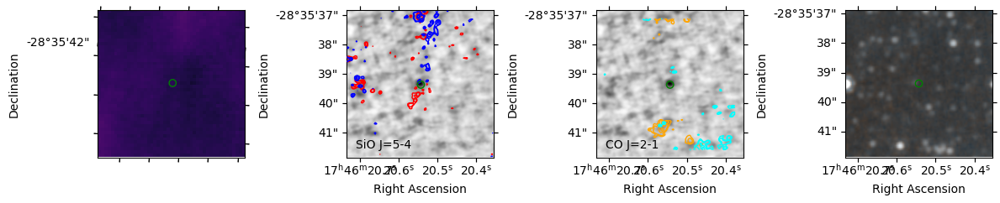

In [179]:
plot_compare_miri_alma(pos9, l, w)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


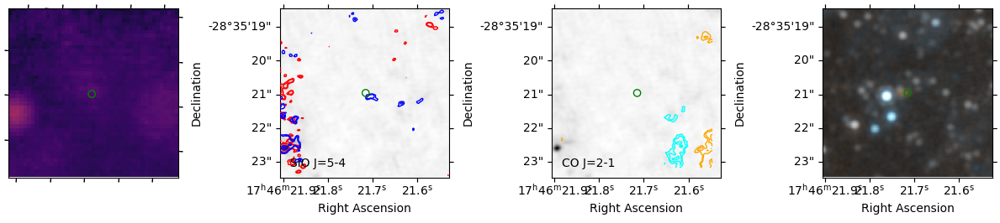

In [177]:
plot_compare_miri_alma(pos_msy, l, w)

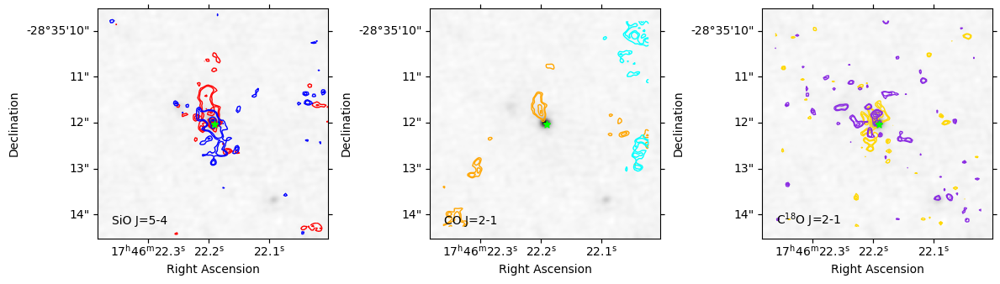

In [44]:
plot_compare_outflow(pos1, l, w)

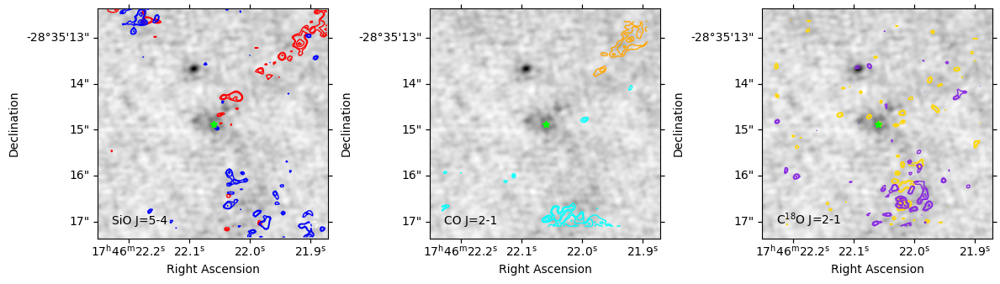

In [45]:
plot_compare_outflow(pos2, l, w)

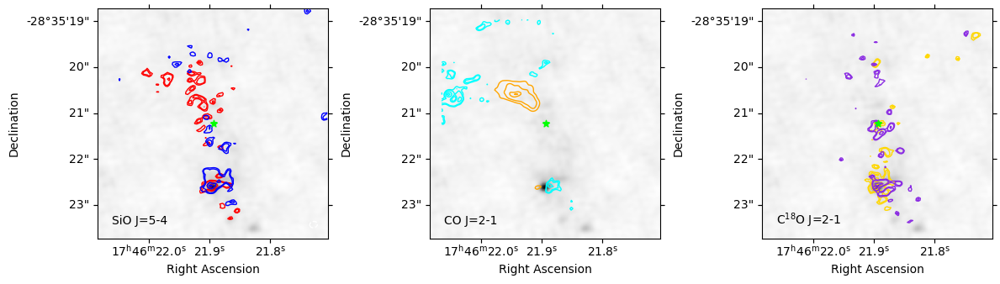

In [46]:
plot_compare_outflow(pos3, l, w)

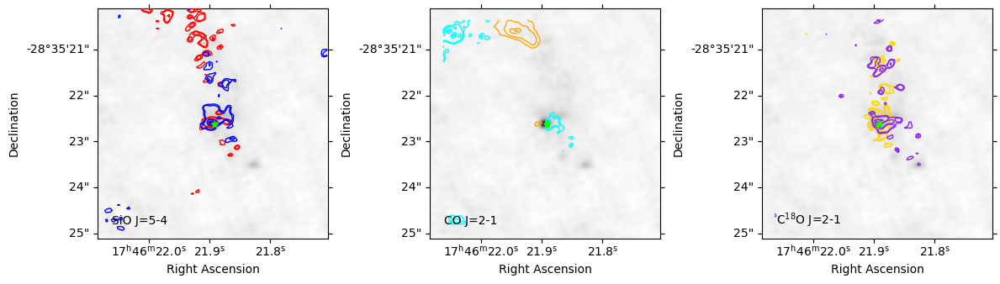

In [47]:
plot_compare_outflow(pos4, l, w)

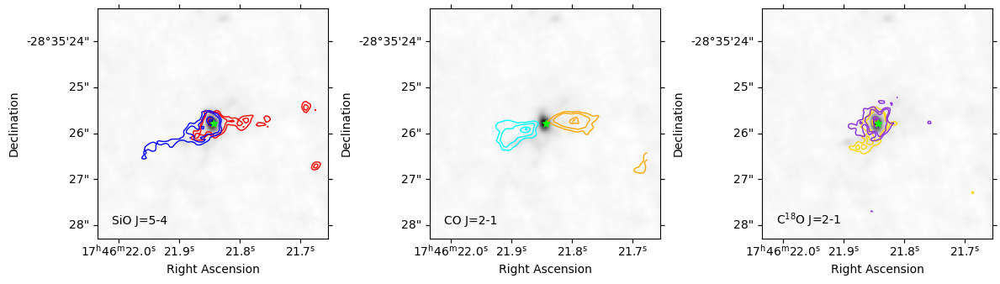

In [48]:
plot_compare_outflow(pos5, l, w)

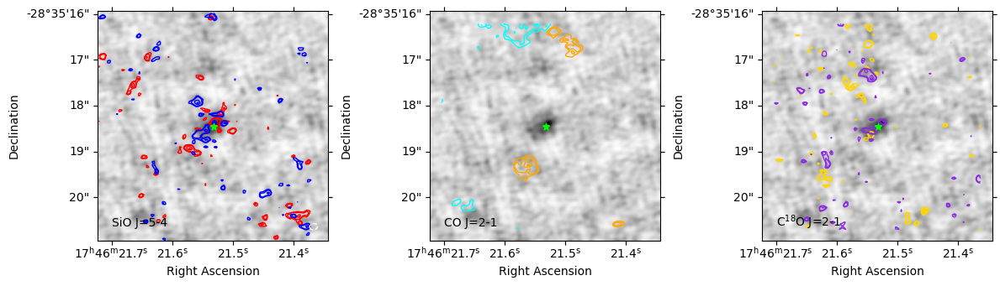

In [49]:
plot_compare_outflow(pos6, l, w)

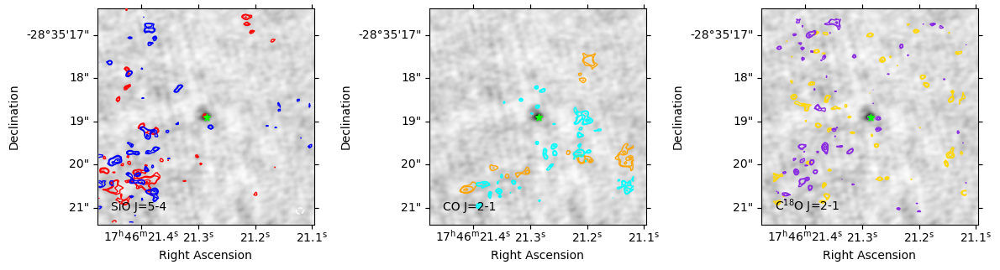

In [50]:
plot_compare_outflow(pos7, l, w)

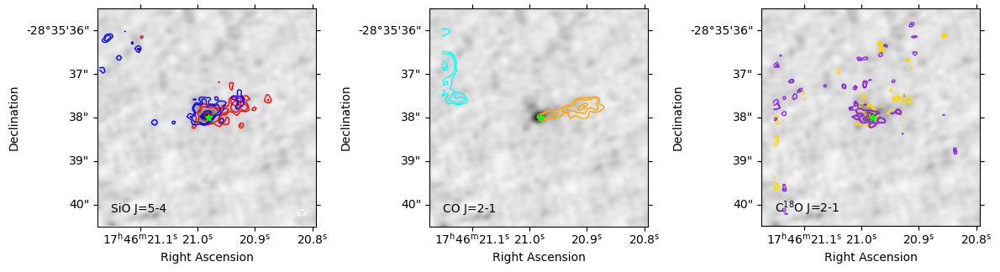

In [51]:
plot_compare_outflow(pos8, l, w)

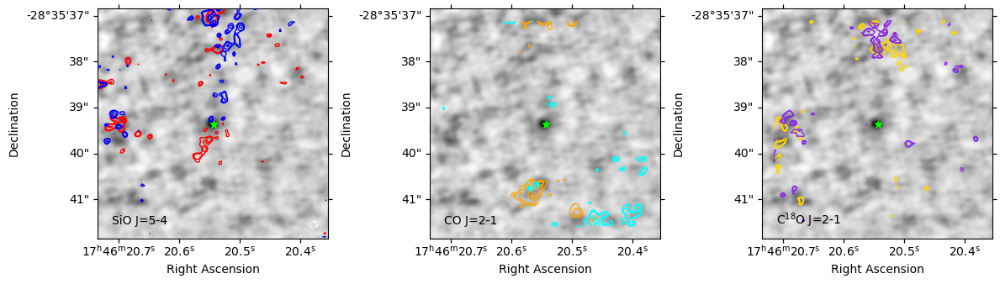

In [52]:
plot_compare_outflow(pos9, l, w)

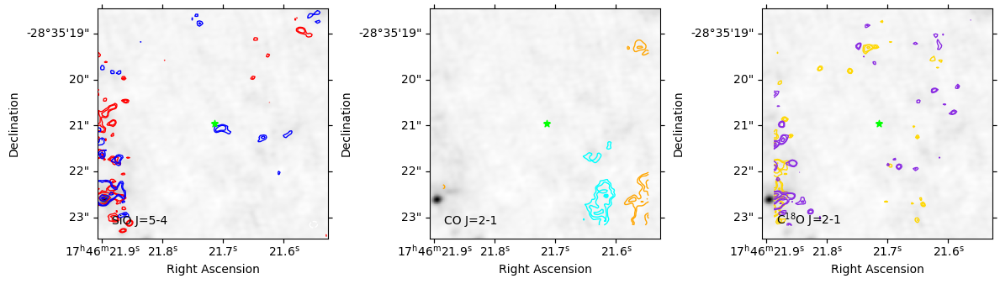

In [53]:
plot_compare_outflow(pos_msy, l, w)

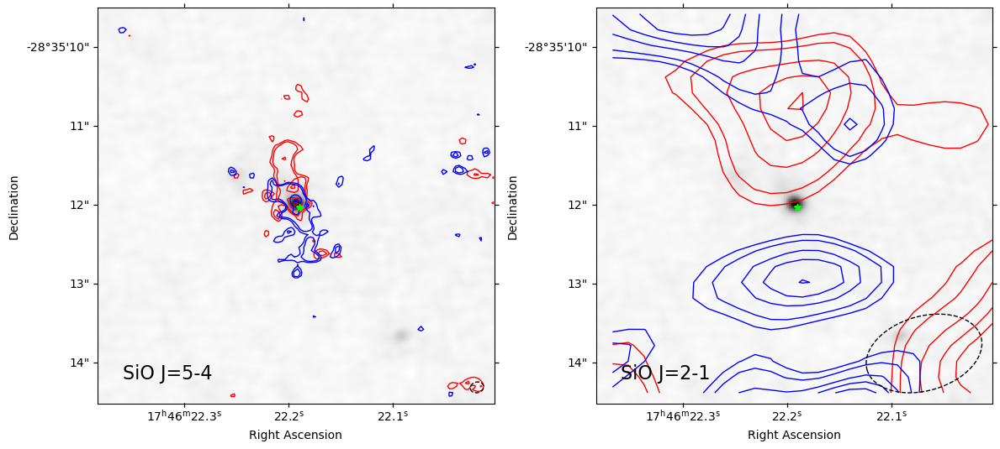

In [11]:
compare_sio_outflows(pos1, 5*u.arcsec, 5*u.arcsec)

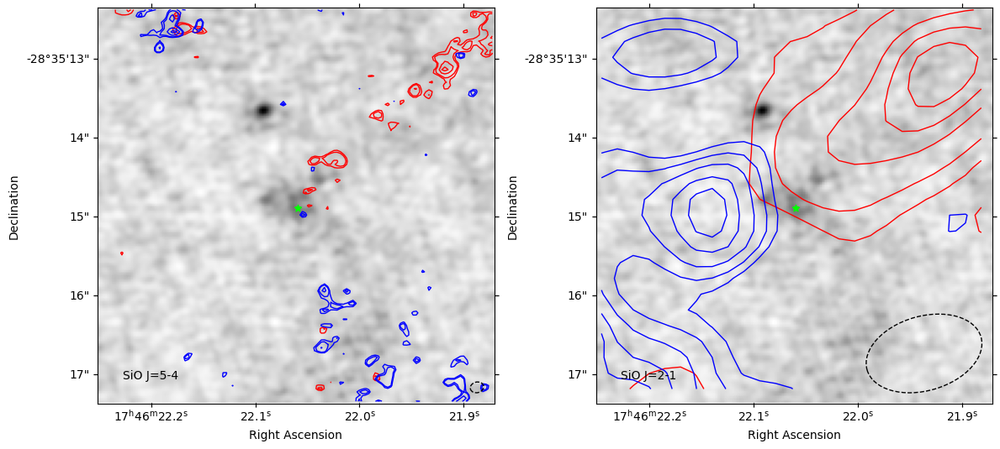

In [122]:
compare_sio_outflows(pos2, 5*u.arcsec, 5*u.arcsec)

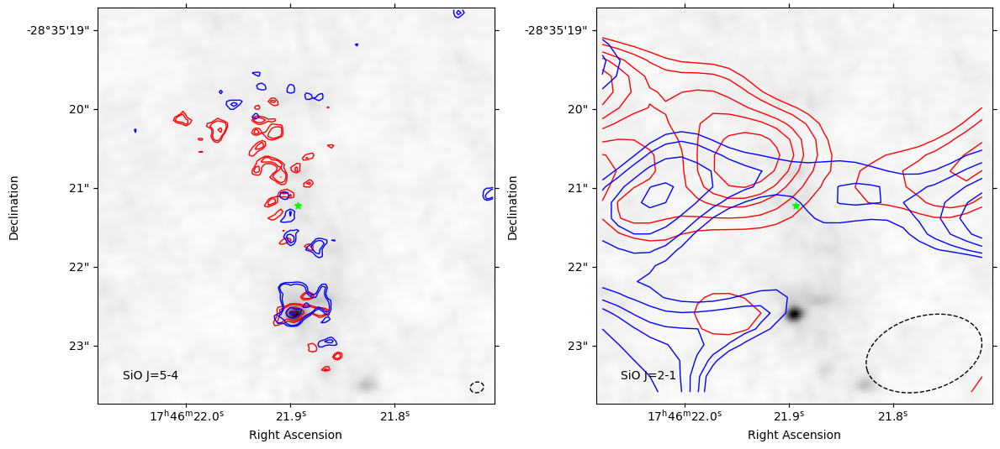

In [124]:
compare_sio_outflows(pos3, l, w)

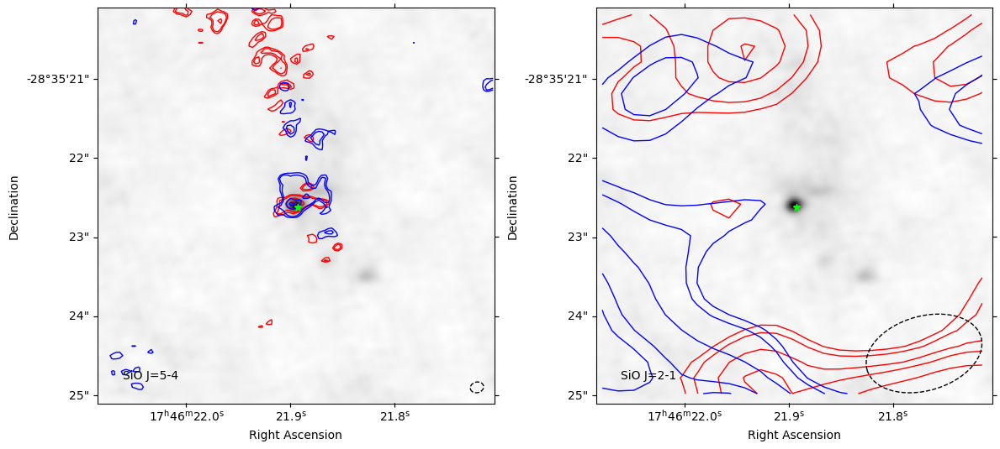

In [125]:
compare_sio_outflows(pos4, l, w)

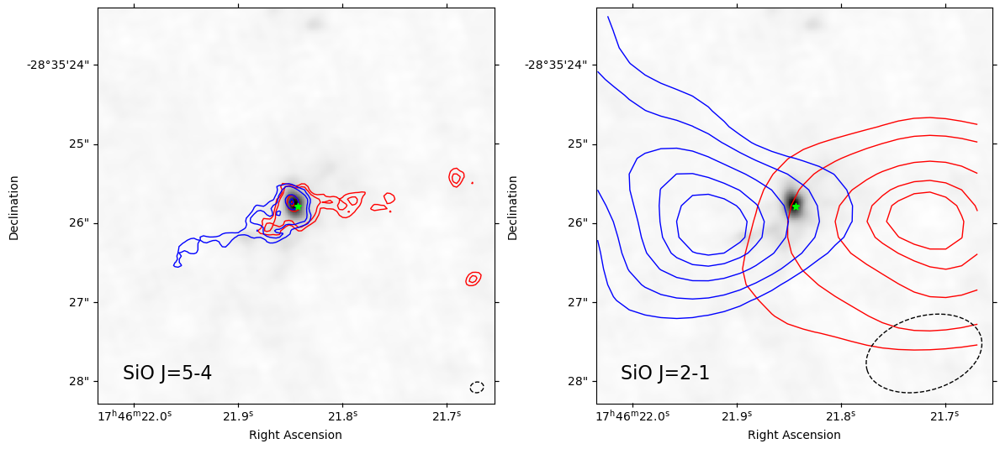

In [12]:
compare_sio_outflows(pos5, l, w)

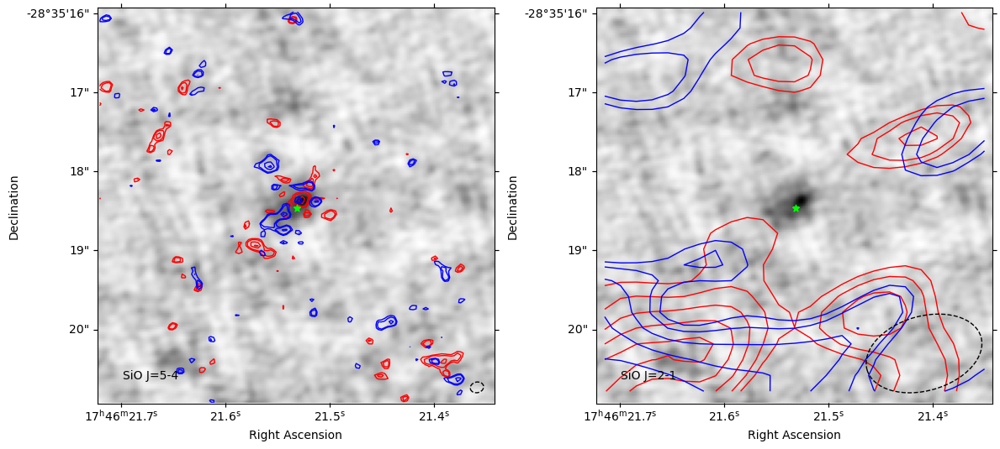

In [127]:
compare_sio_outflows(pos6, l, w)

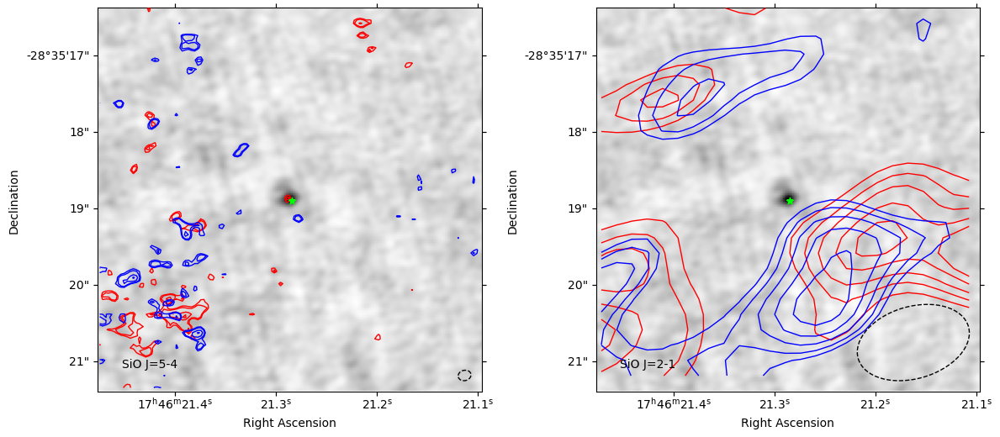

In [128]:
compare_sio_outflows(pos7, l, w)

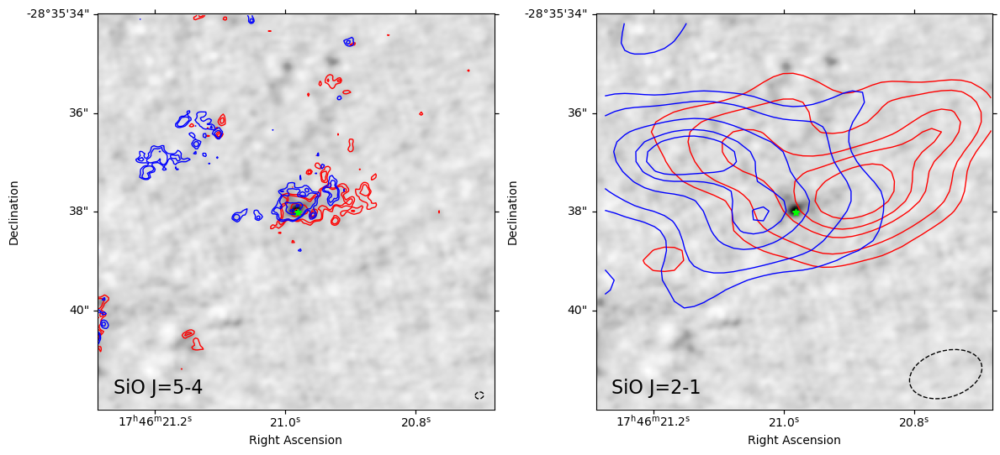

In [13]:
compare_sio_outflows(pos8, 8*u.arcsec, 8*u.arcsec)

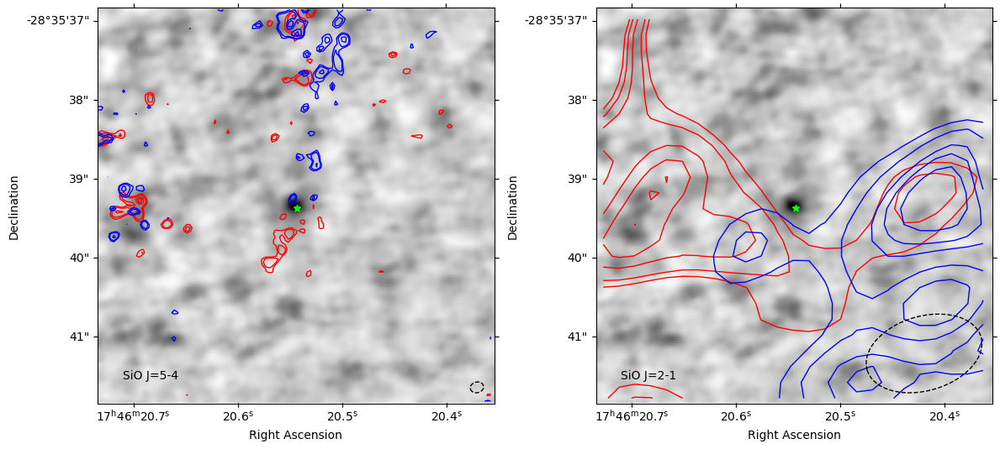

In [130]:
compare_sio_outflows(pos9, l, w)

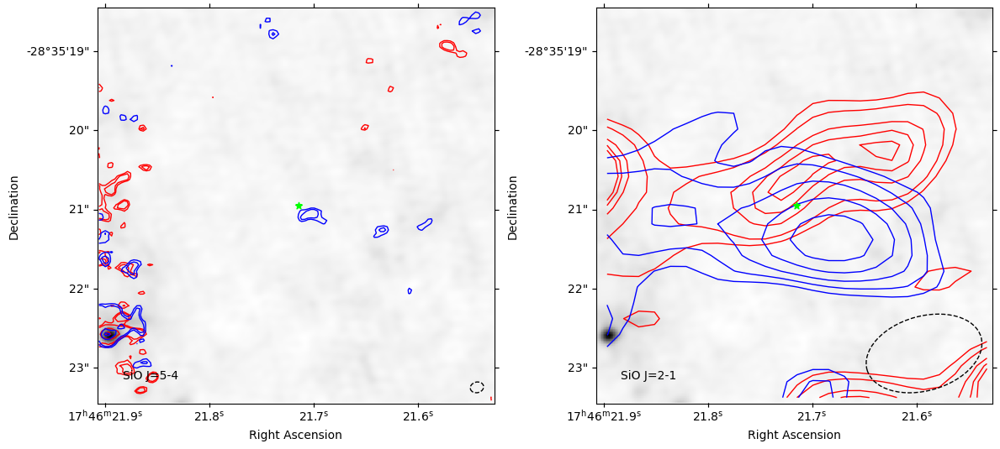

In [131]:
compare_sio_outflows(pos_msy, l, w)

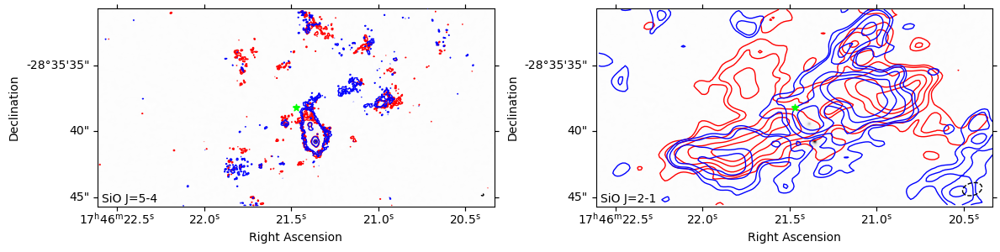

In [133]:
compare_sio_outflows(position_hmsfr, 15*u.arcsec, 30*u.arcsec)

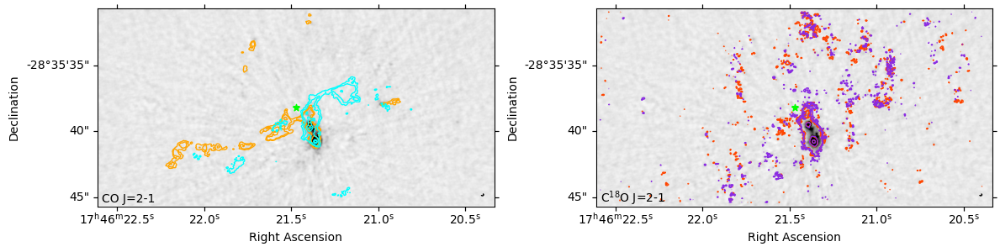

In [26]:
compare_co_outflows(position_hmsfr, 15*u.arcsec, 30*u.arcsec)

# MIRI - ALMA - NIRCam Comparison Plots

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


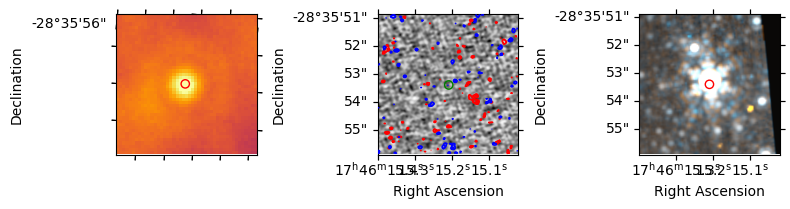

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


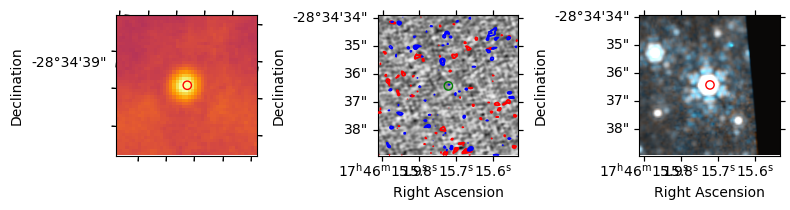

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


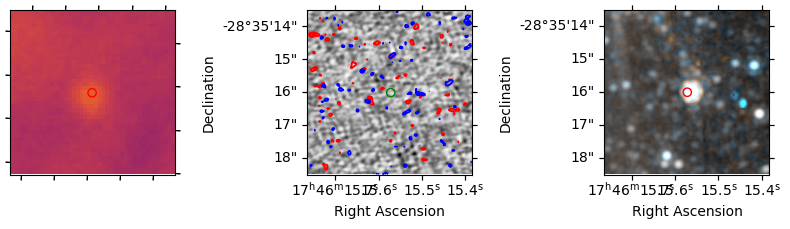

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


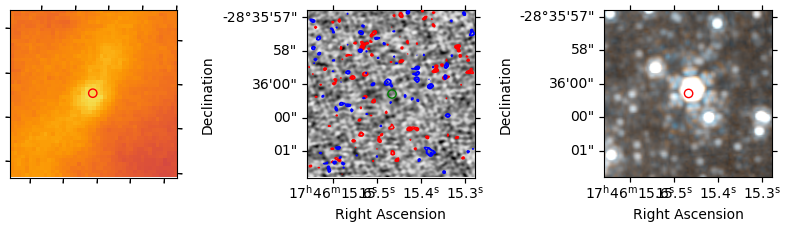

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


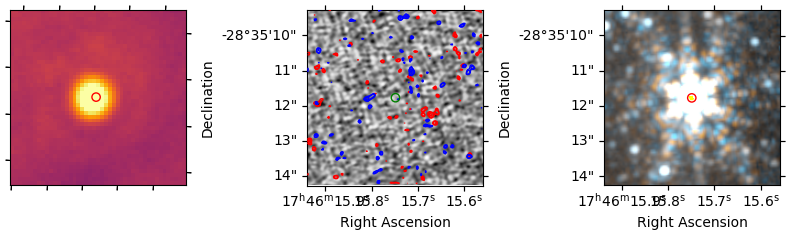

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


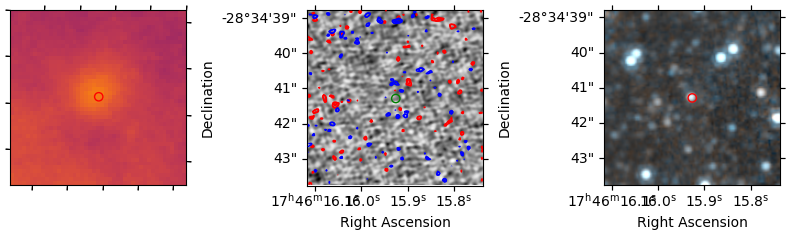

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


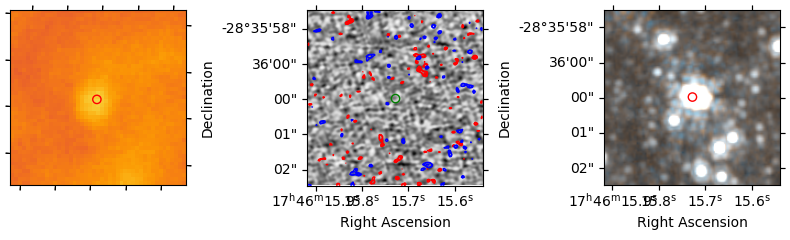

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


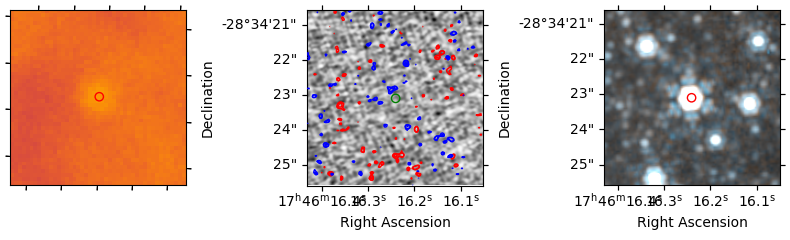

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


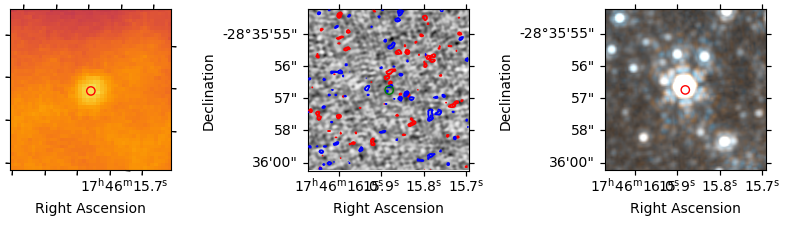

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


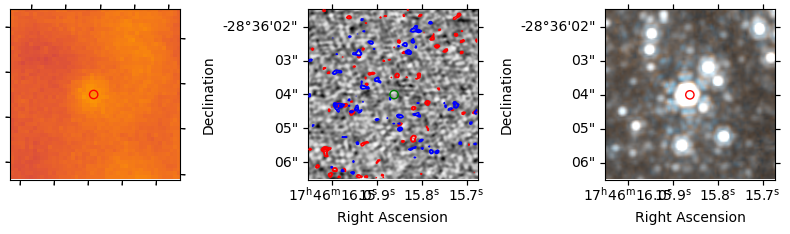

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


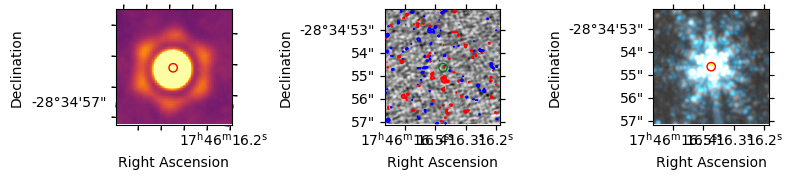

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


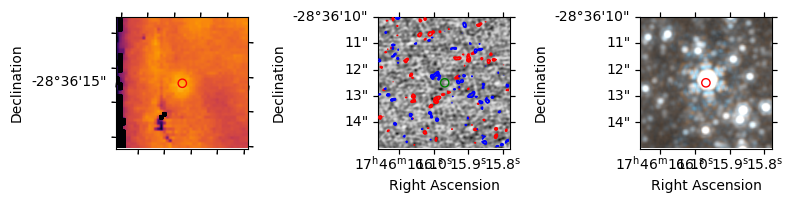

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


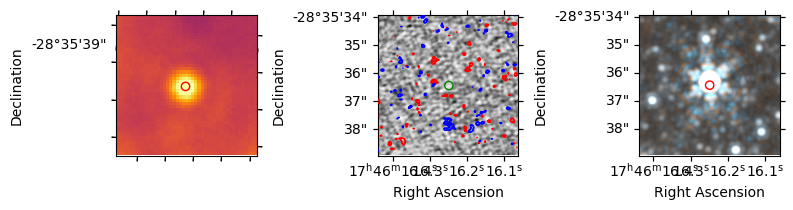

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


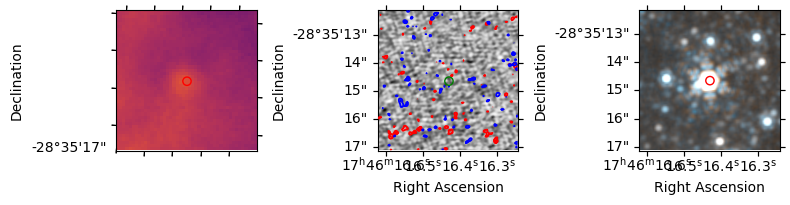

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


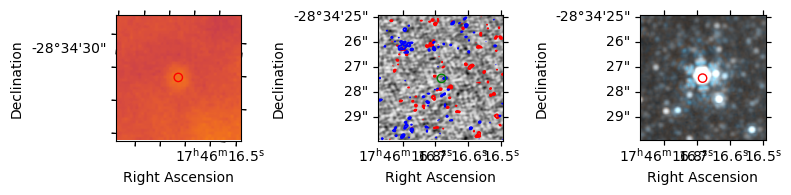

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


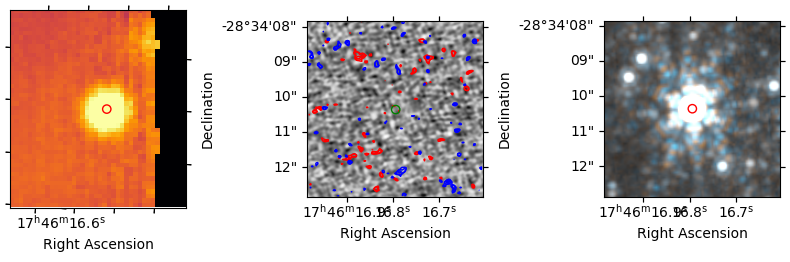

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


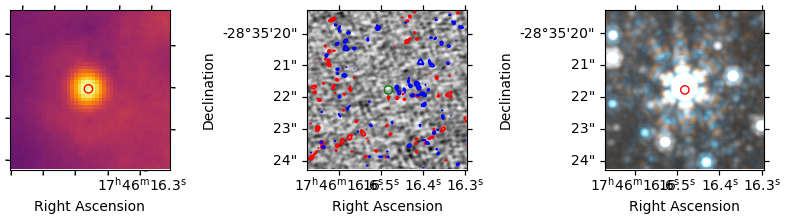

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


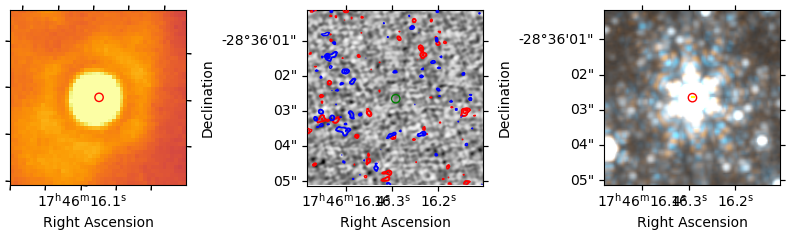

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


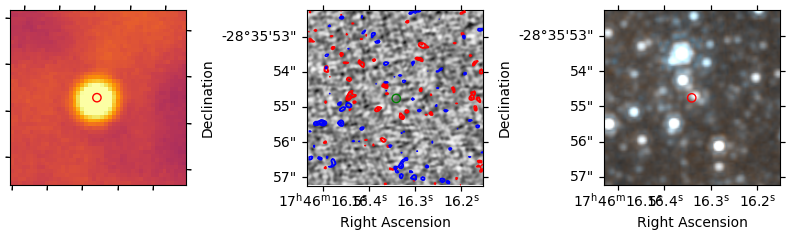

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


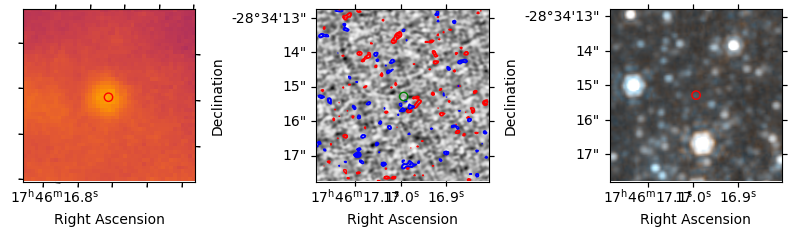

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


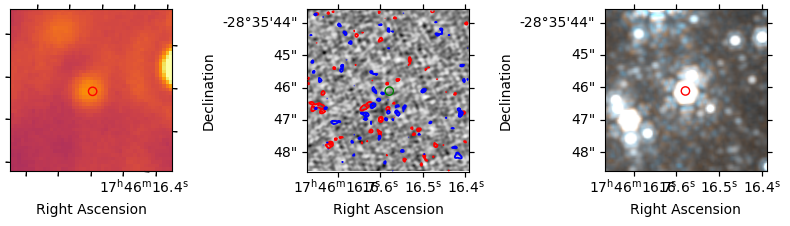

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


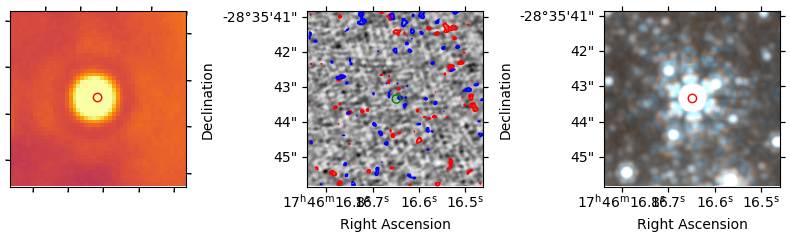

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


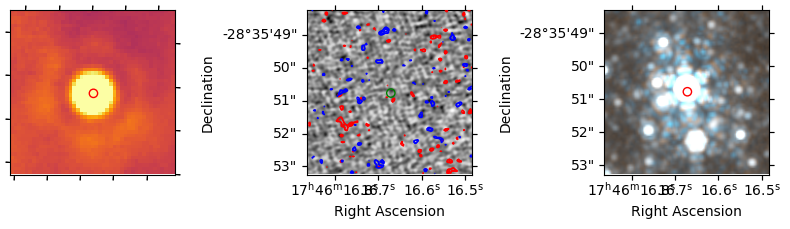

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


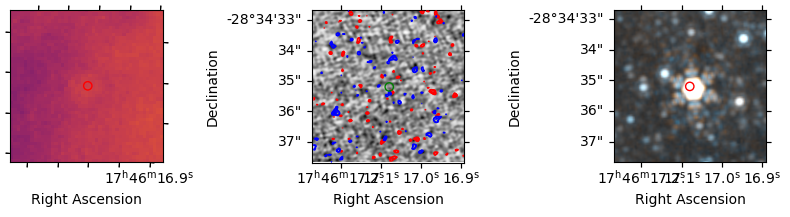

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


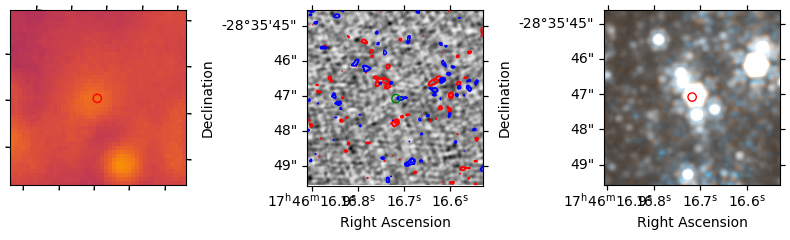

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


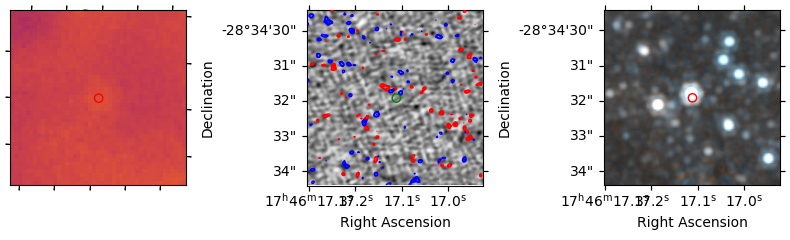

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


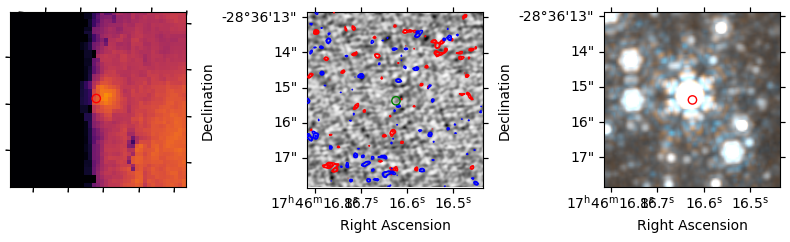

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


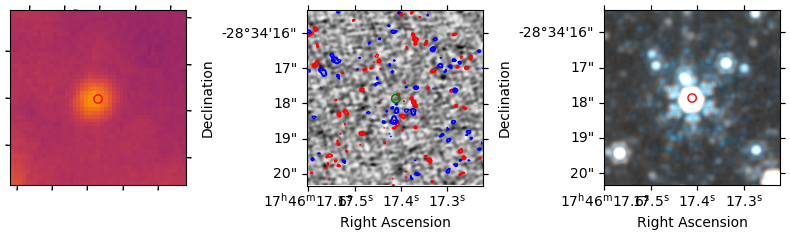

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


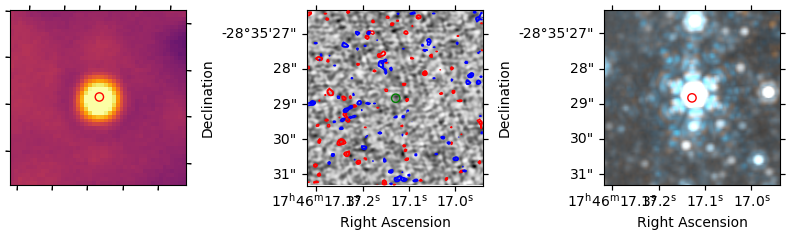

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


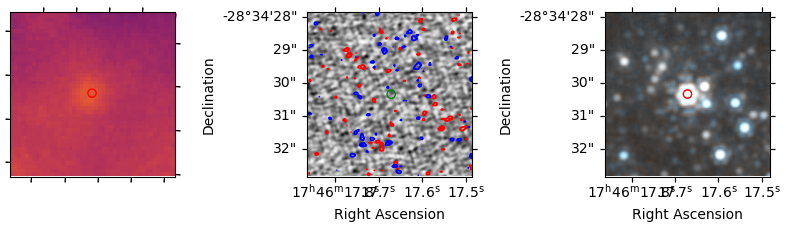

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


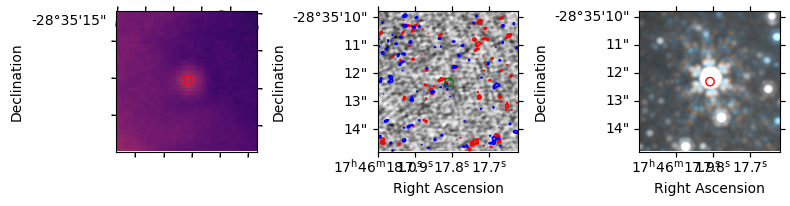

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


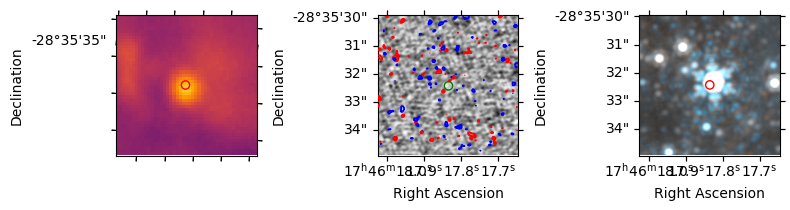

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


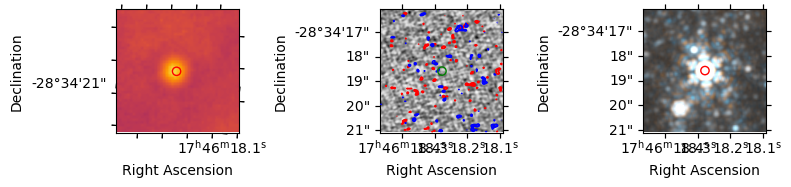

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


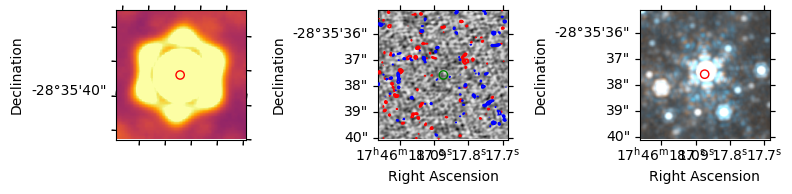

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


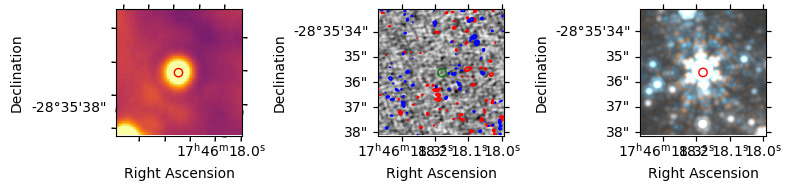

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


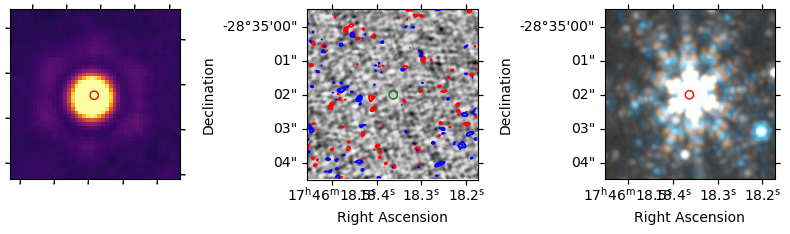

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


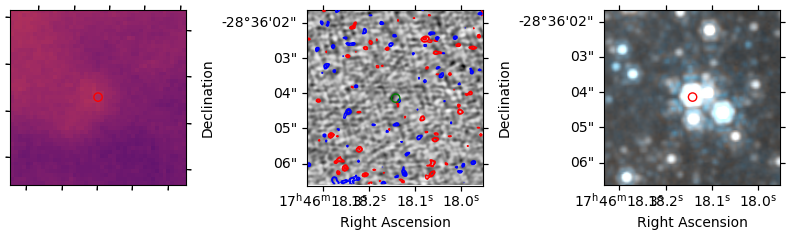

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


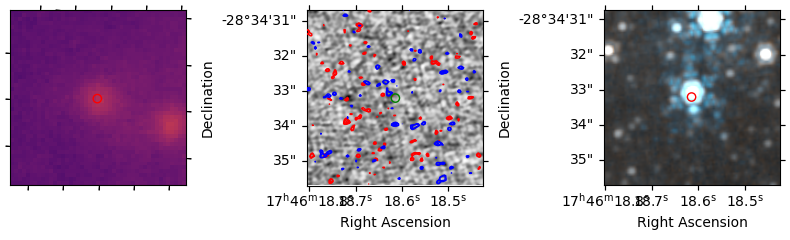

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


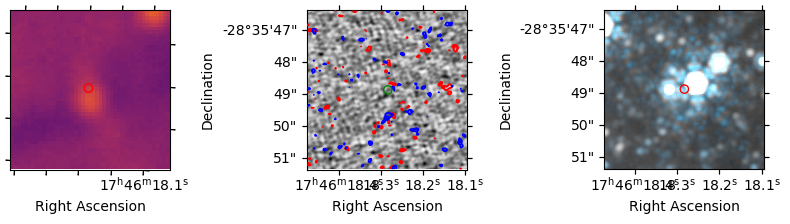

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


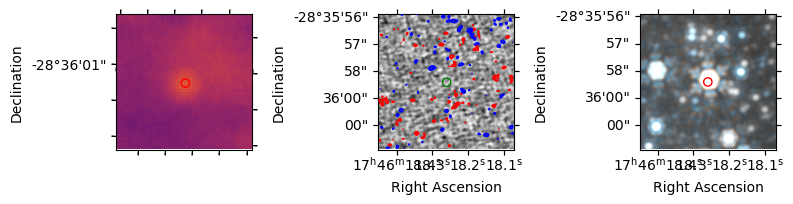

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


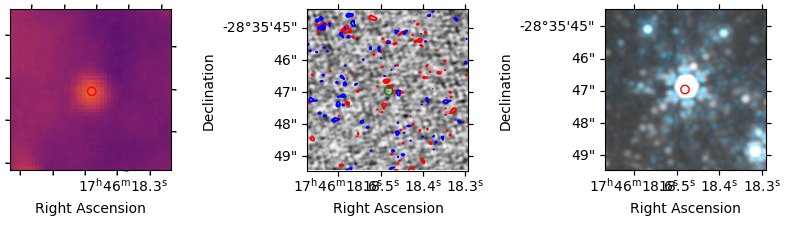

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


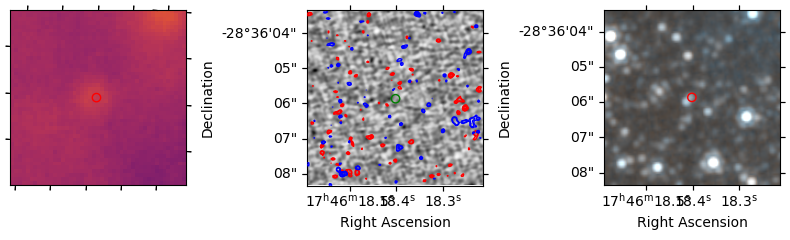

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


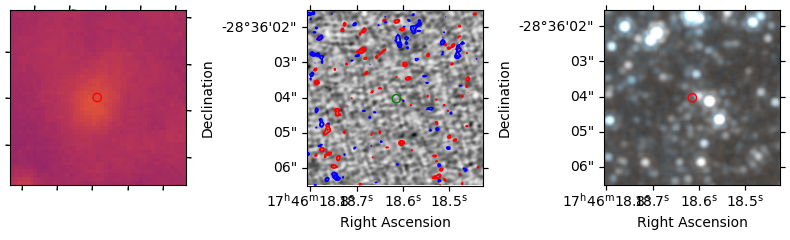

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


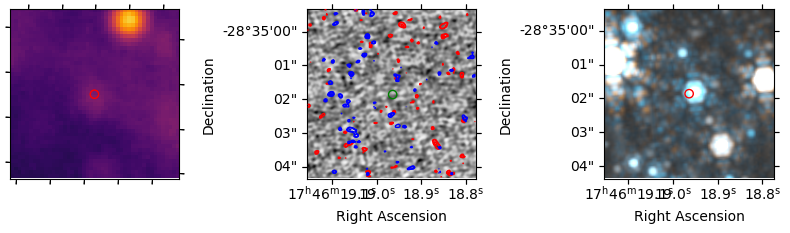

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


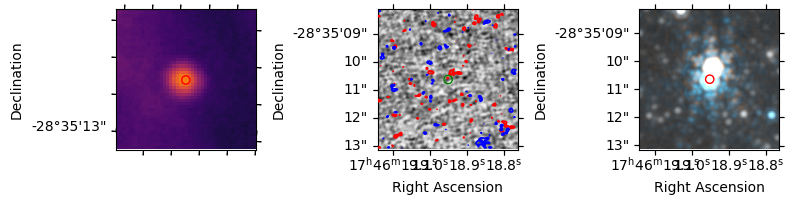

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


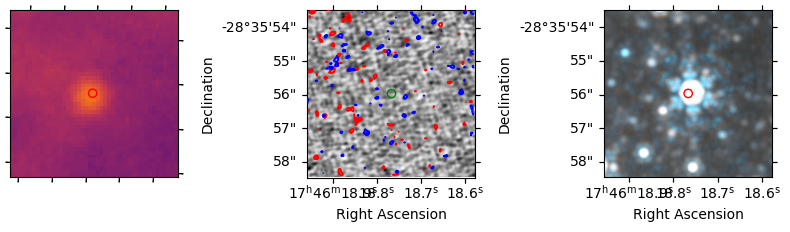

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


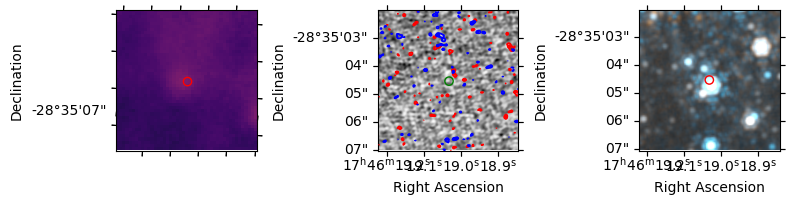

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


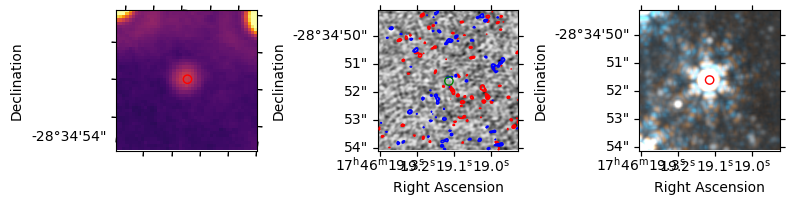

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


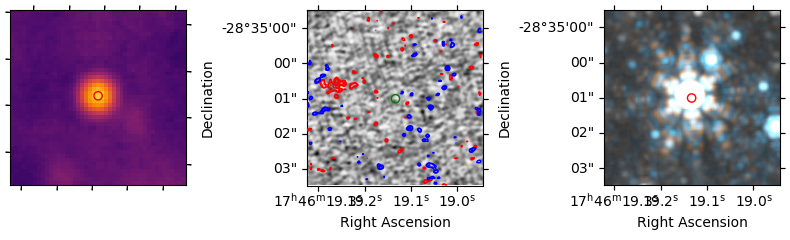

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


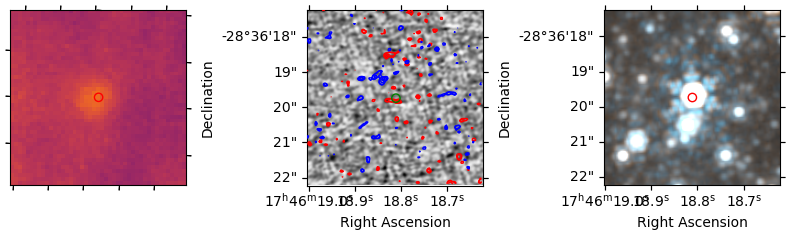

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


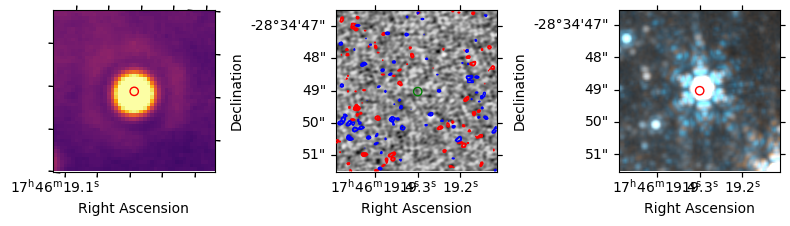

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


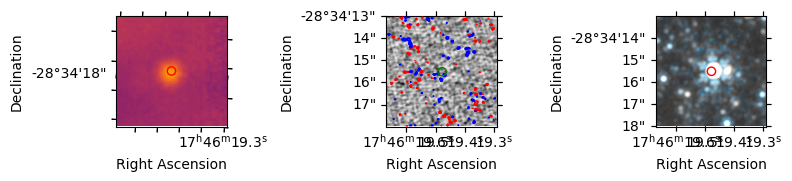

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


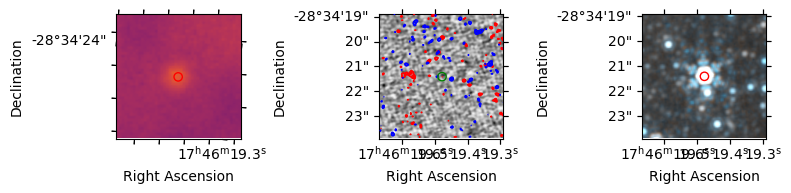

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


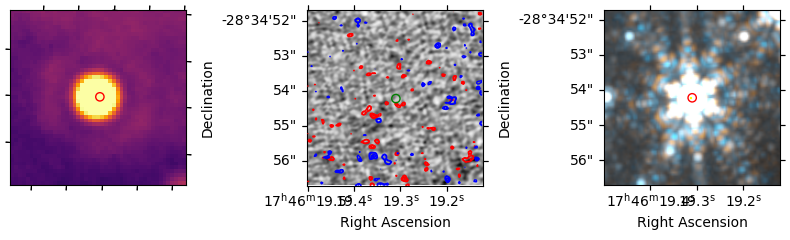

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


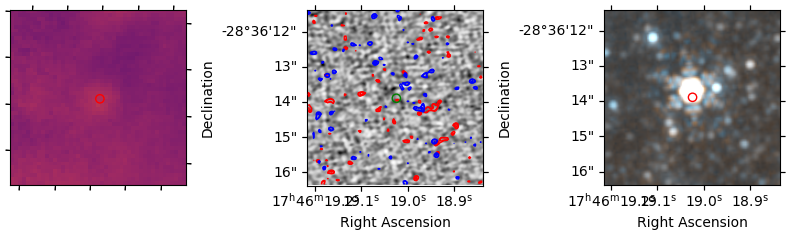

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


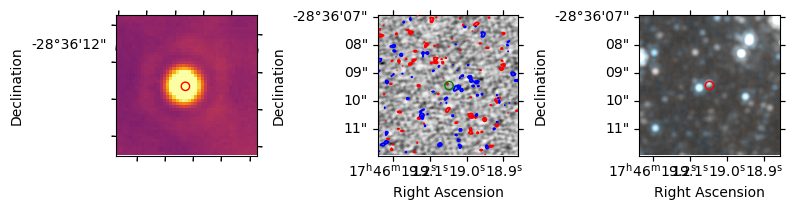

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


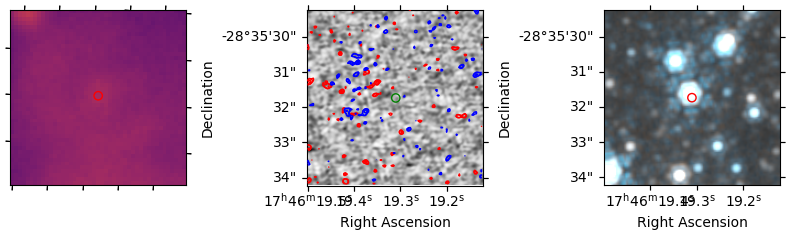

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


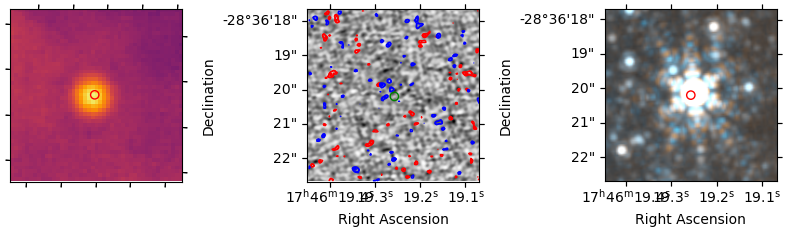

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


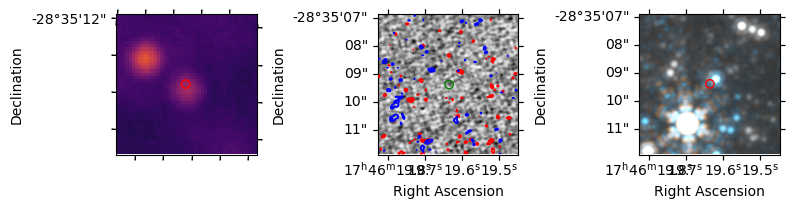

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


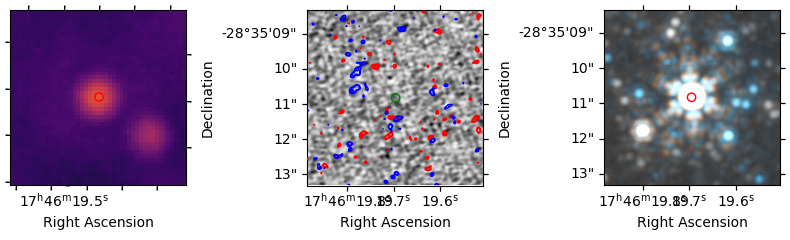

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


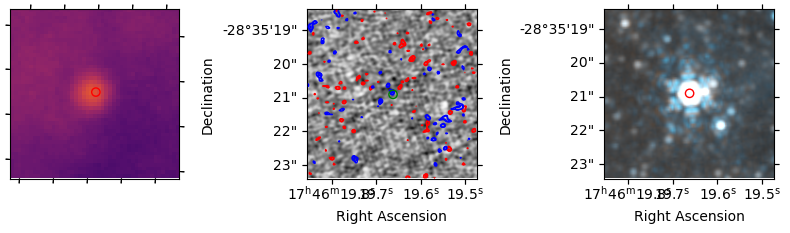

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


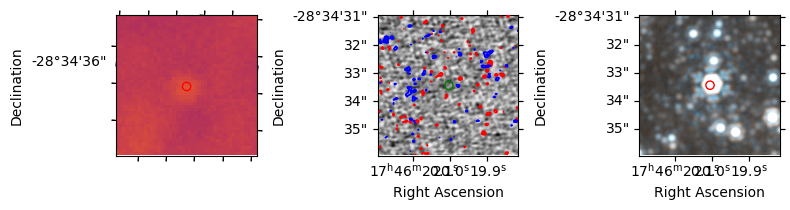

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


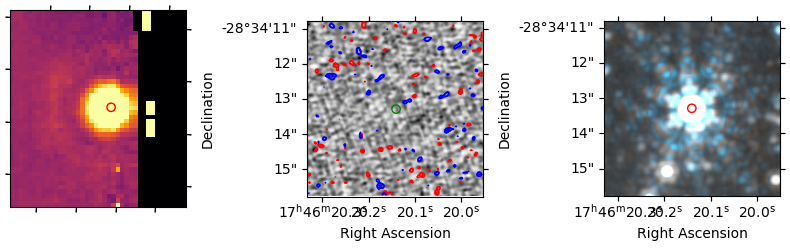

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


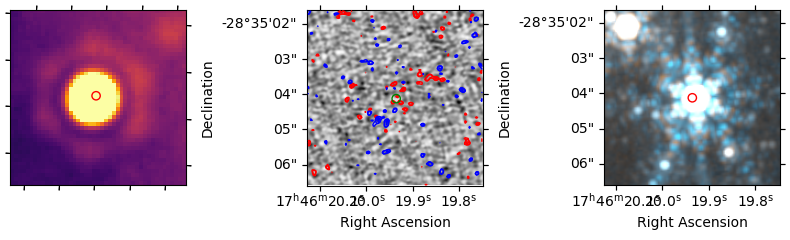

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


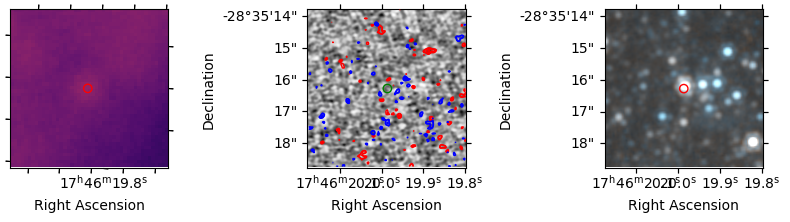

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


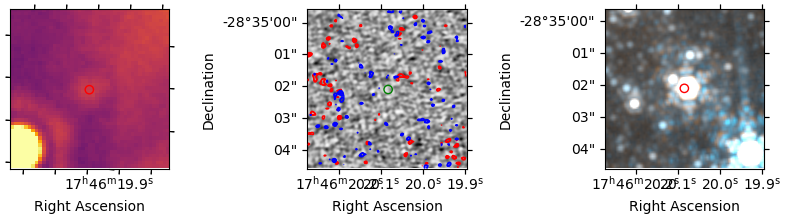

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


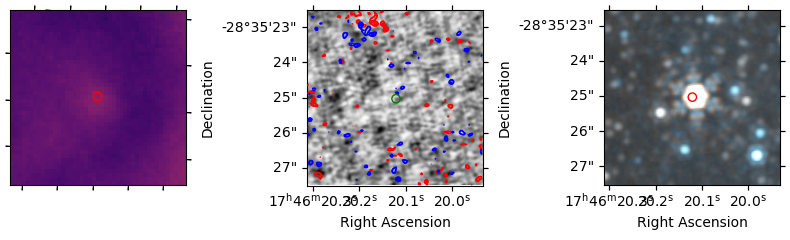

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


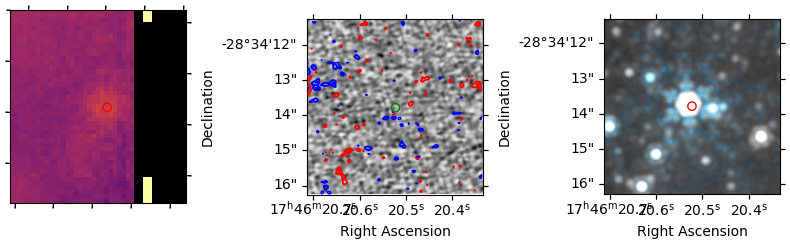

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


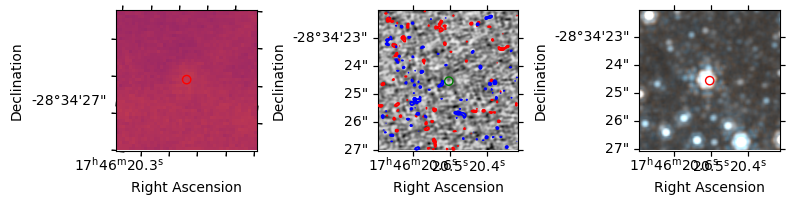

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


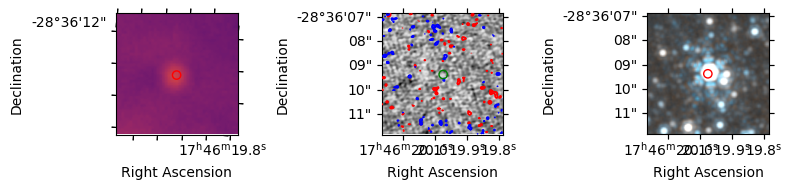

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


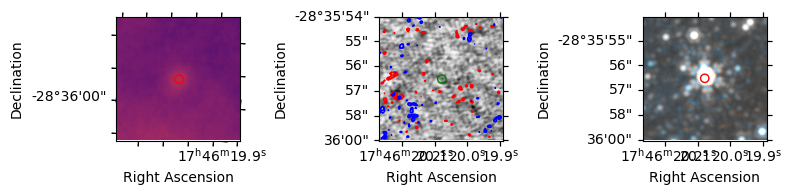

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


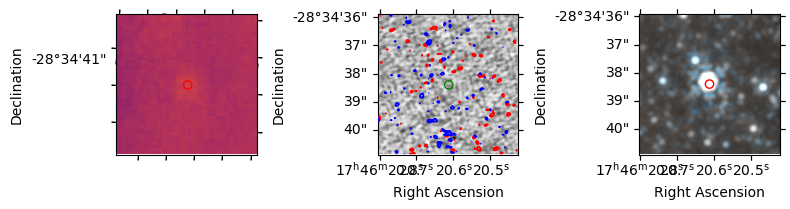

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


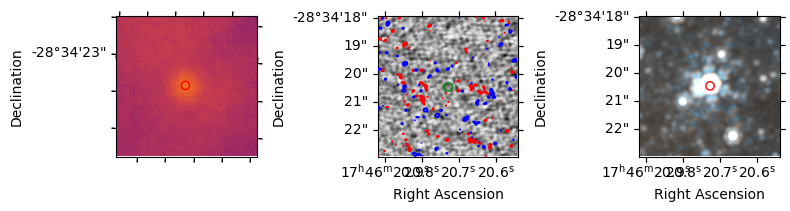

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


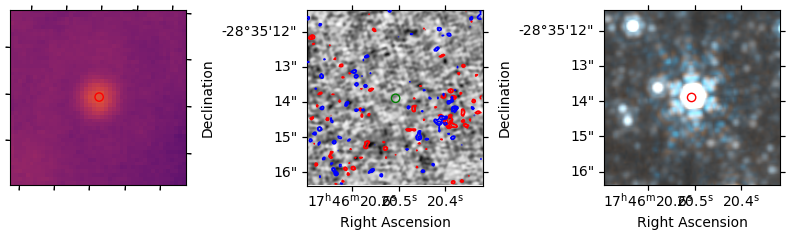

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


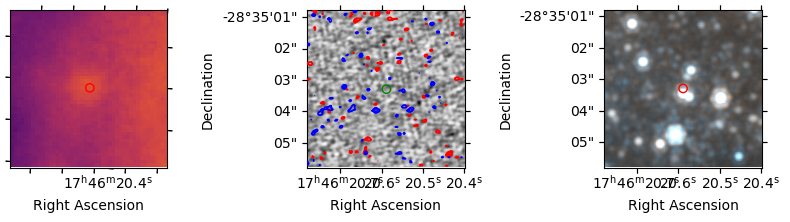

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


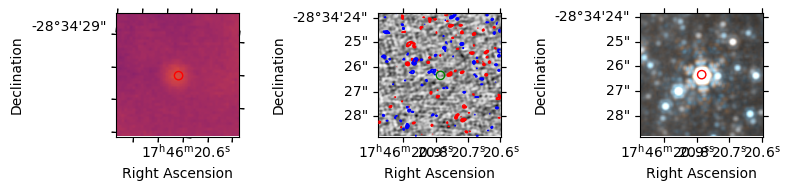

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


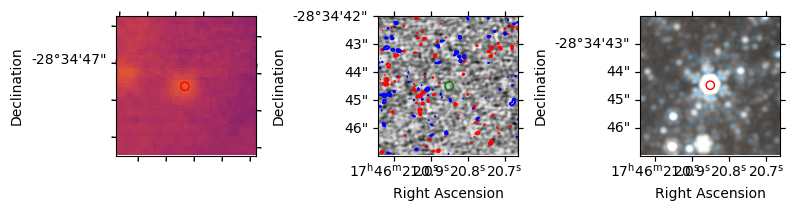

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


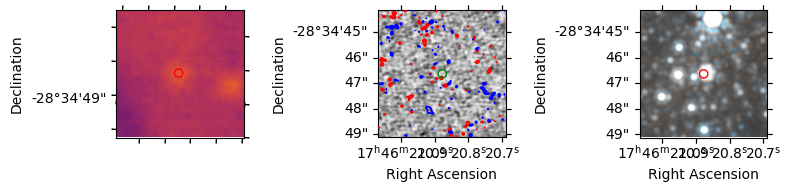

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


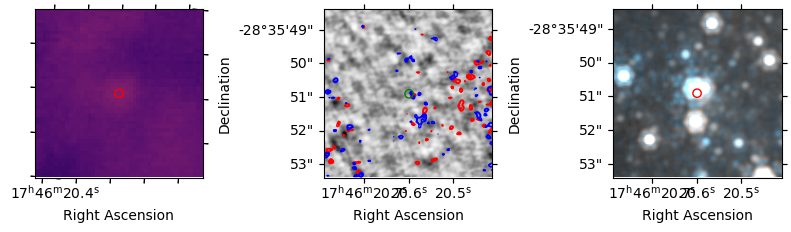

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


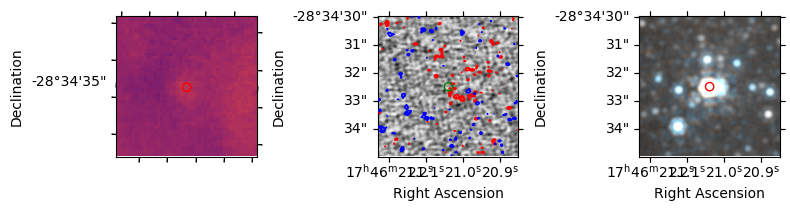

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


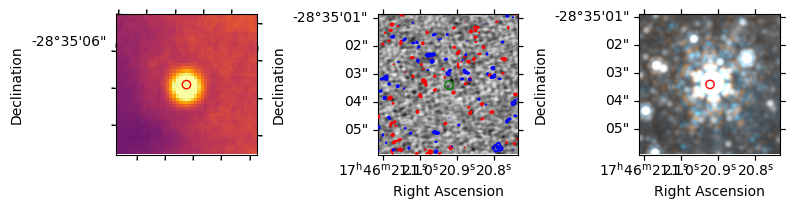

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


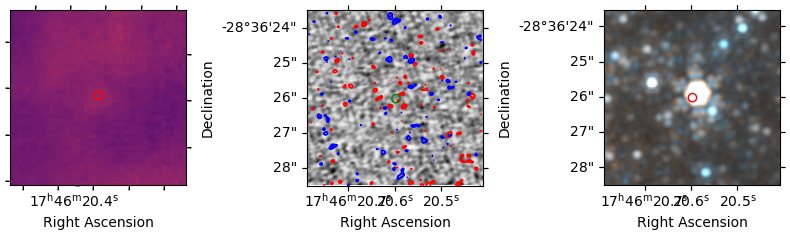

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


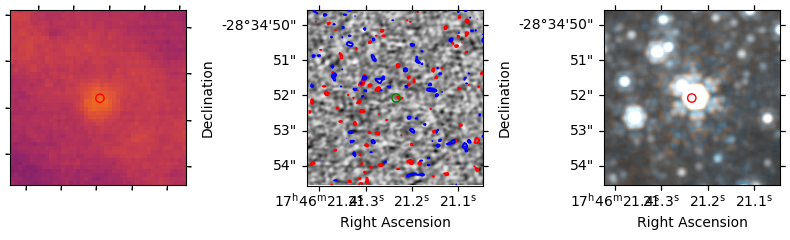

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


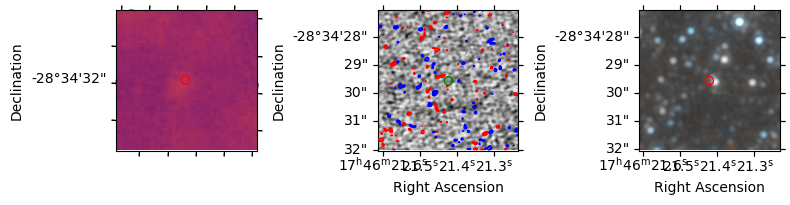

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


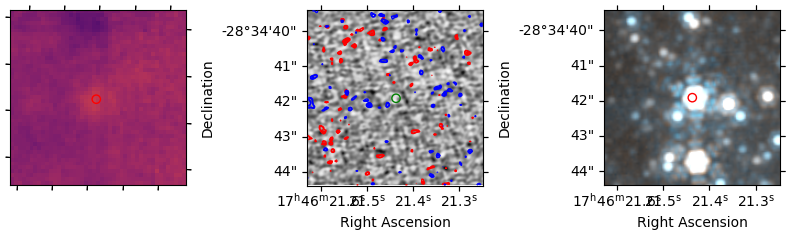

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


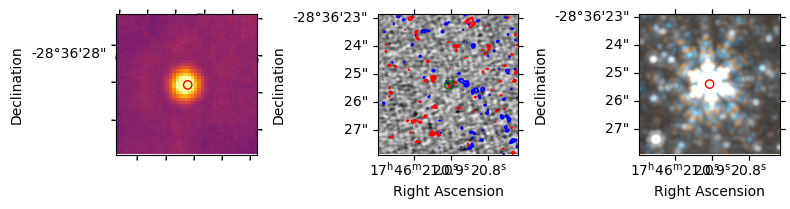

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


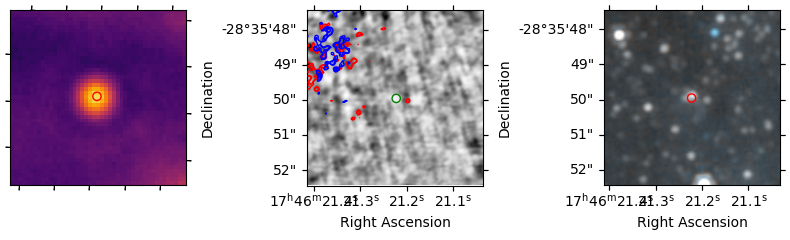

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


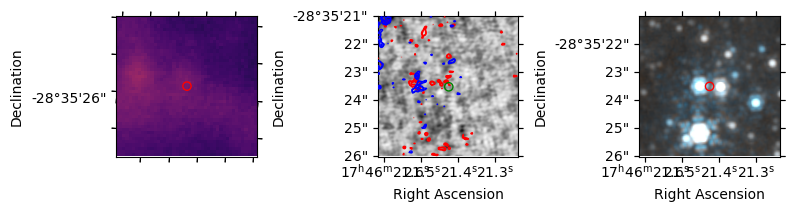

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


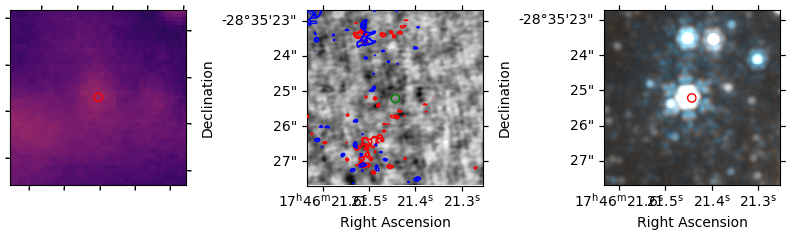

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


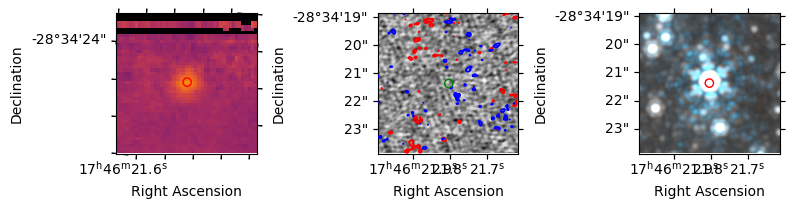

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


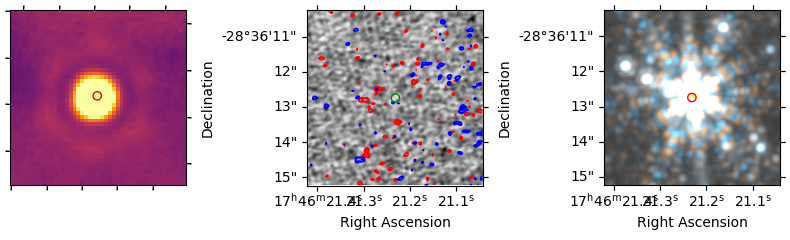

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


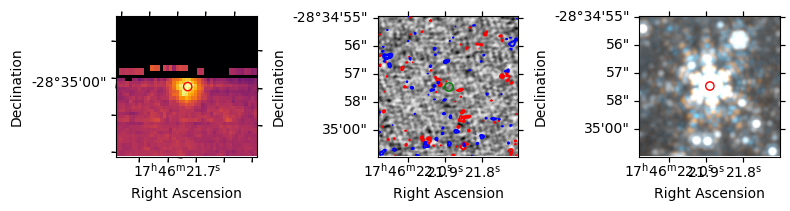

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


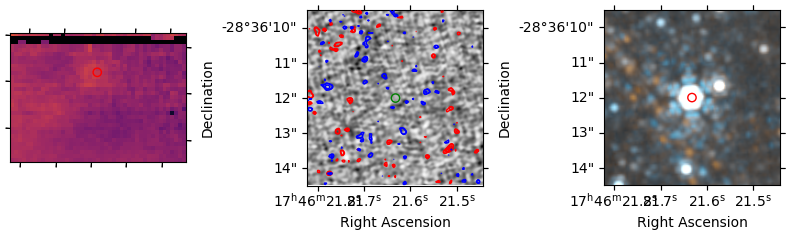

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


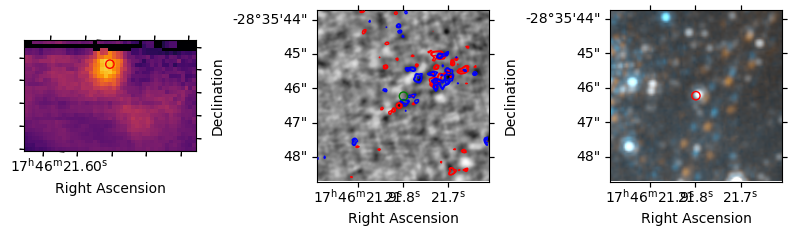

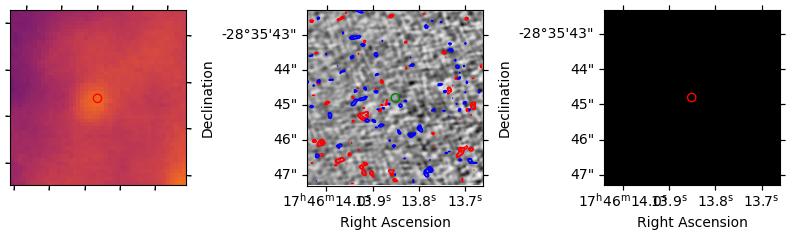

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


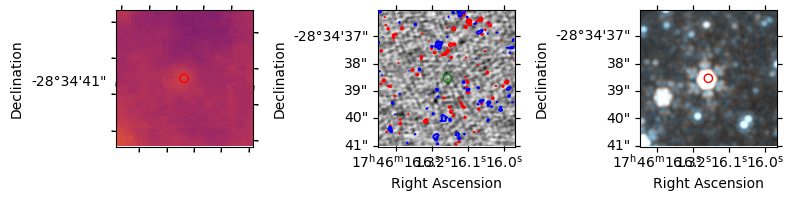

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


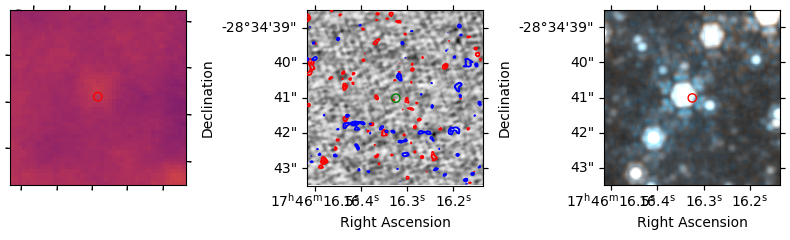

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


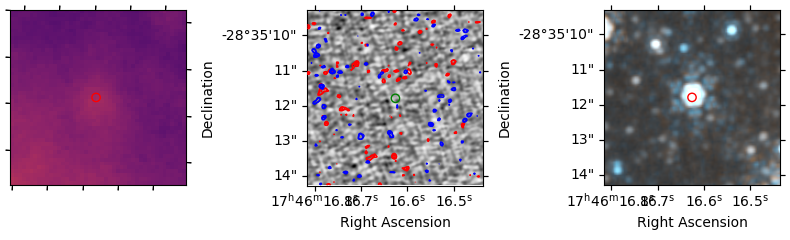

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


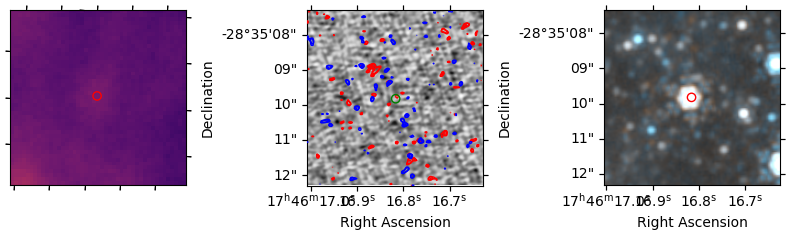

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


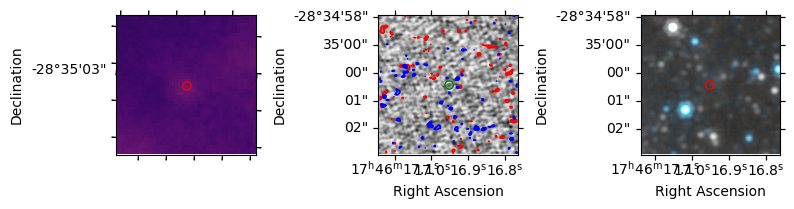

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


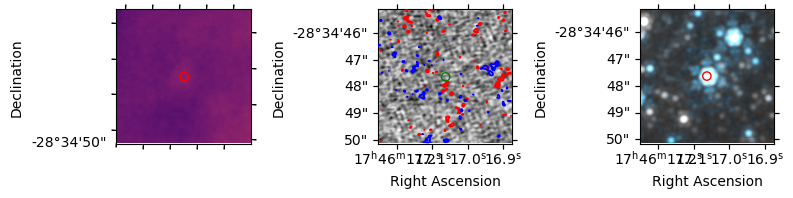

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


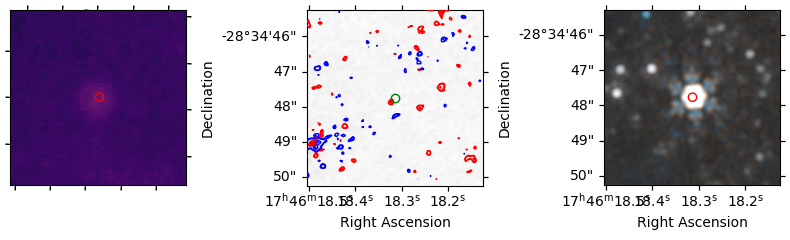

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


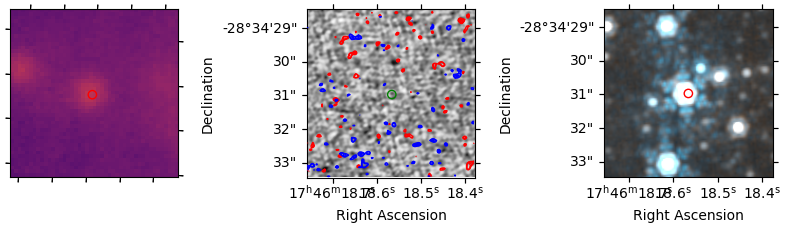

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


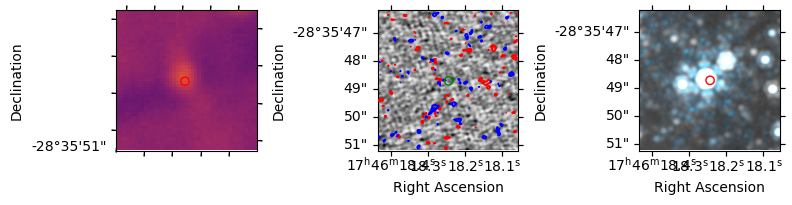

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


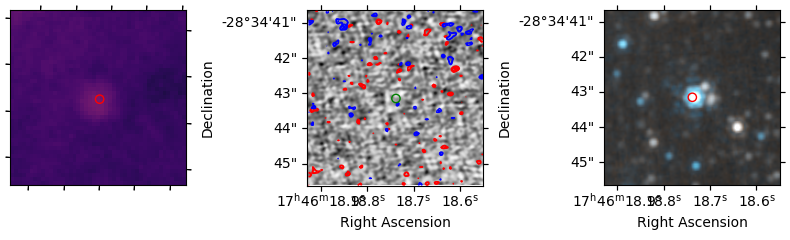

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


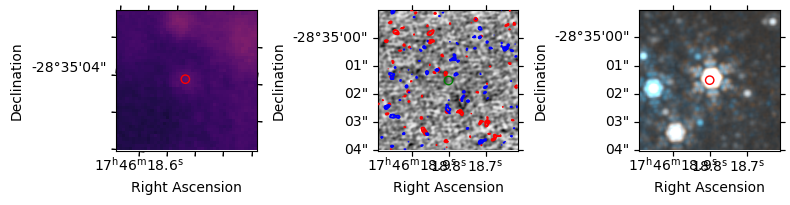

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


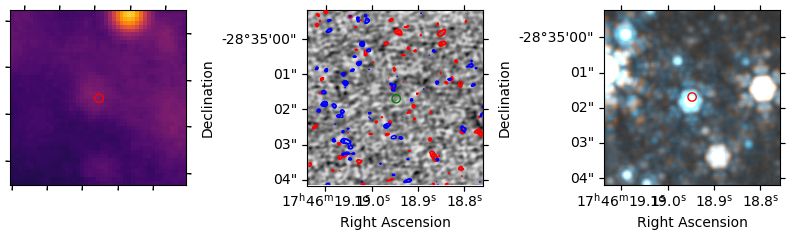

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


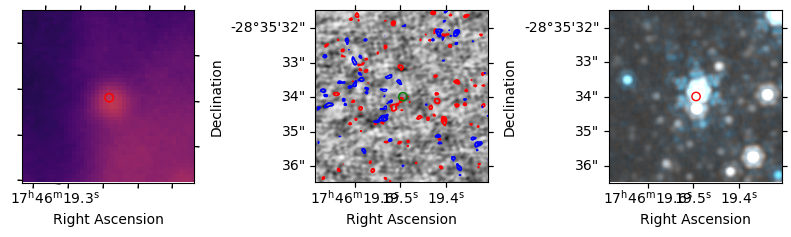

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


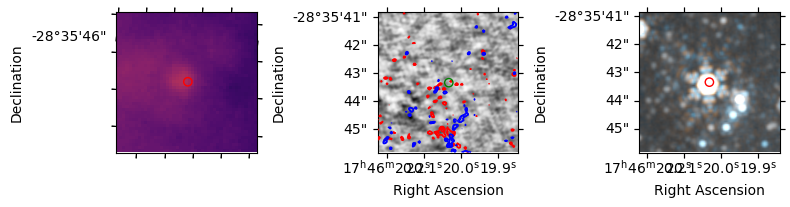

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


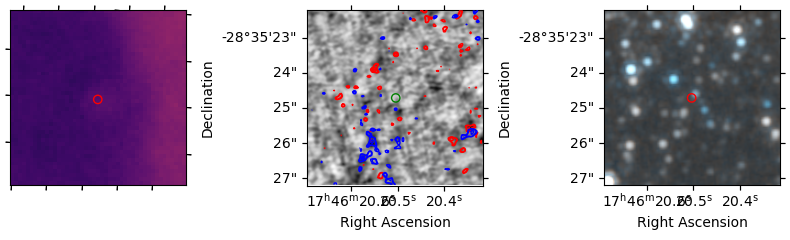

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


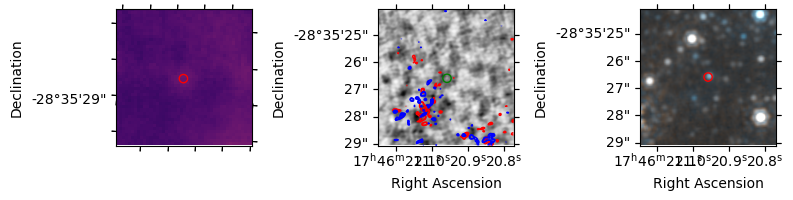

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


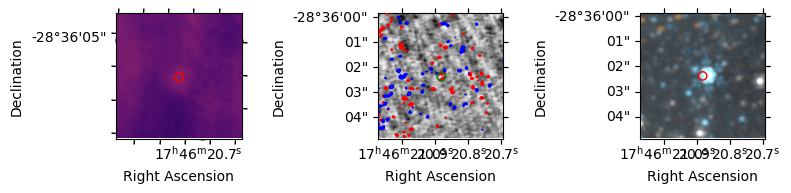

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


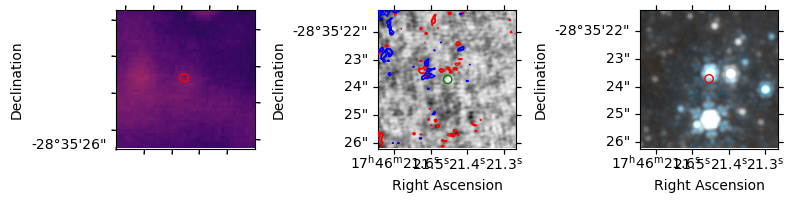

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


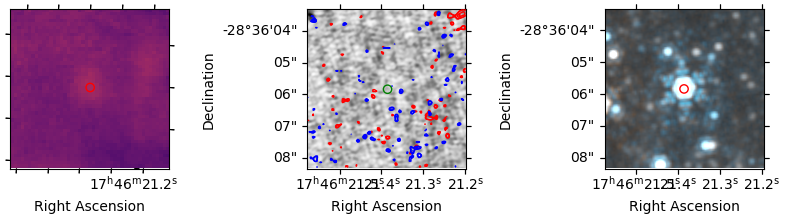

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


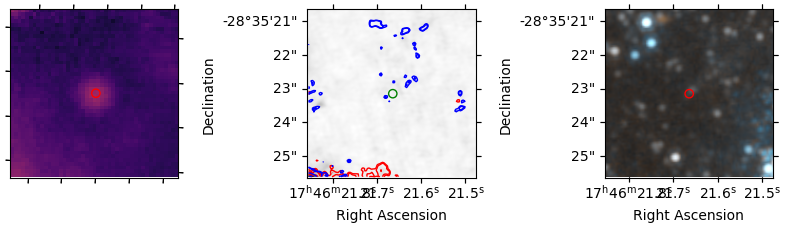

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


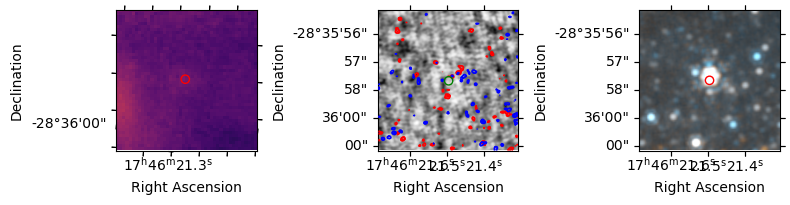

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


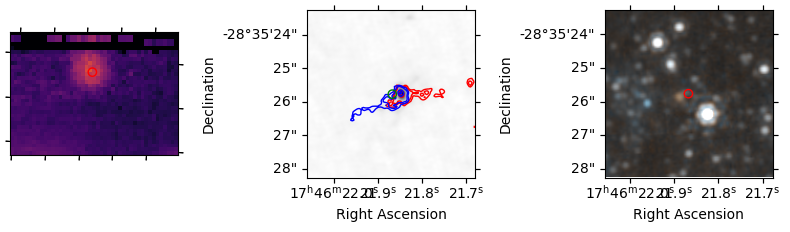

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


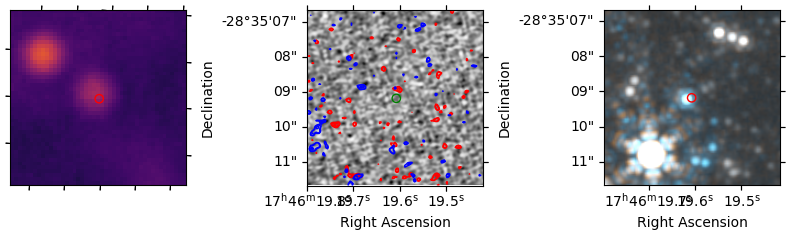

In [68]:
for pos in cat_in['skycoord'][32:]:
    plot_compare_miri_alma(pos, l, w)